### Final annotation of T/NK cells


Preprocessing:
- T/NK cells from main object subsetted
- performed scvi batch correction to prepare objects with cell cycle gene regression

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/T.hvg5000_noCC.scvi_output.with_annotv2_v3.22021124.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 192786 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

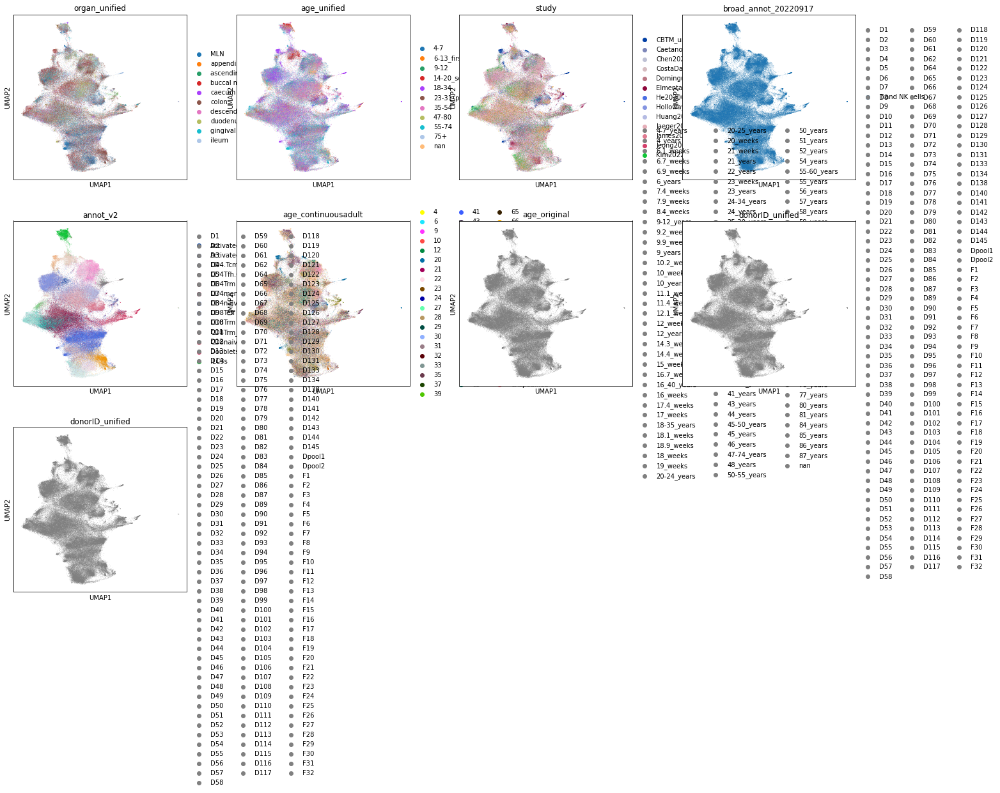

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2','age_continuousadult','age_original','donorID_unified','donorID_unified'],cmap='OrRd')

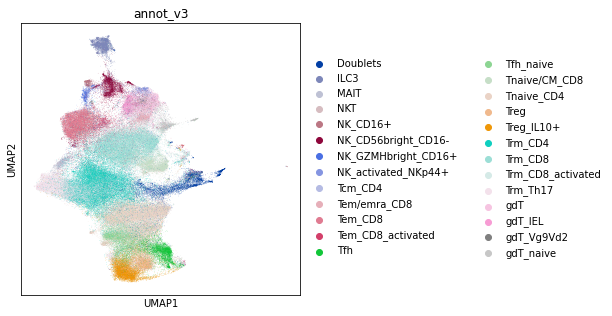

In [5]:
sc.pl.umap(adata,color='annot_v3')

In [6]:
adata.X.max()

8327.0

In [7]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [8]:
adata.X.max()

8.925046

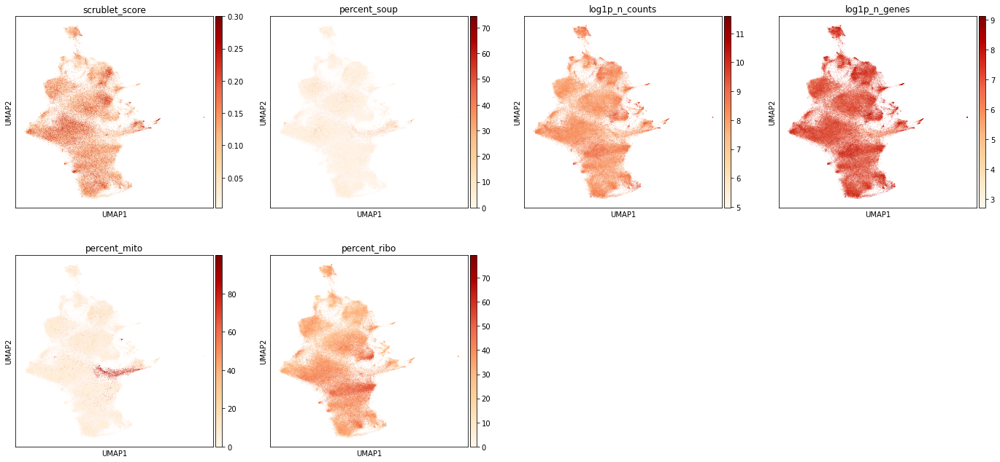

In [9]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

In [10]:
sc.tl.leiden(adata, resolution = 1, neighbors_key="neighbors_scvi")

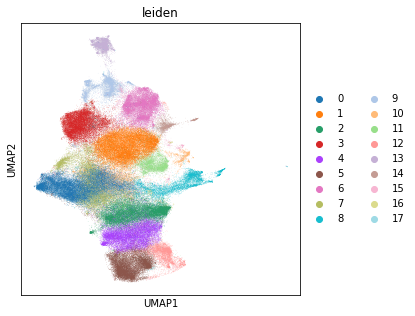

In [11]:
sc.pl.umap(adata,color=['leiden'])

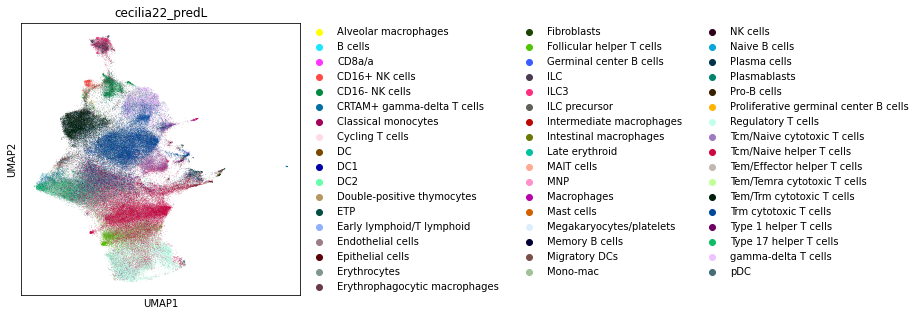

In [12]:
sc.pl.umap(adata,color='cecilia22_predL')

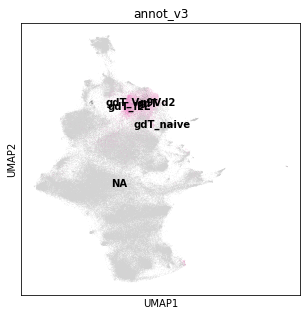

In [13]:
sc.pl.umap(adata,color='annot_v3',groups=['gdT','gdT_IEL','gdT_Vg9Vd2','gdT_naive'],legend_loc='on data')

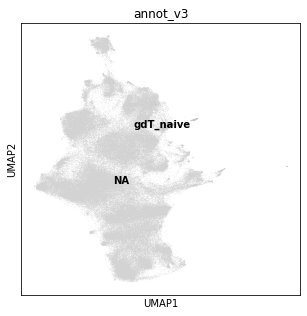

In [14]:
sc.pl.umap(adata,color='annot_v3',groups=['gdT_naive'],legend_loc='on data')

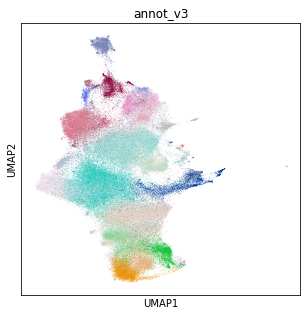

In [15]:
sc.pl.umap(adata,color='annot_v3',legend_loc='on_data')

In [16]:
doub = adata[adata.obs.leiden.isin(['10','8'])].copy()

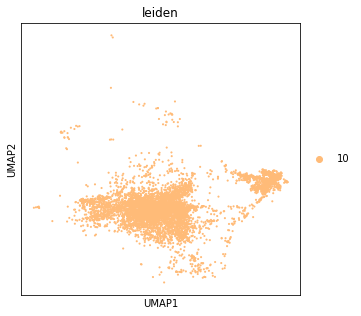

In [17]:
sc.pl.umap(doub,color='leiden')

In [33]:
doub.obs['annot_v3'] = (
    doub.obs["leiden"]
    .map(lambda x: {'10':'Doublets','8':'Doublets'
    }.get(x, x))
    .astype("category")
)

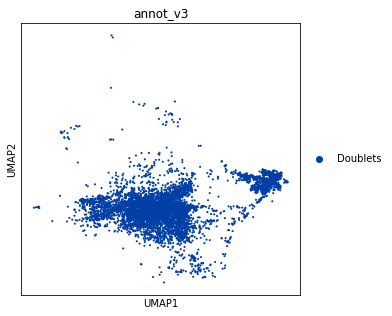

In [34]:
sc.pl.umap(doub,color='annot_v3')

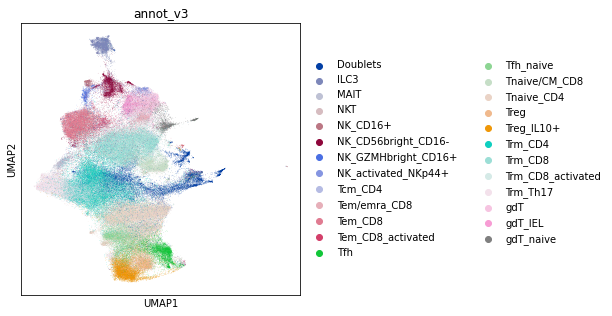

In [35]:
ON = {O:N for O,N in zip(doub.obs_names,doub.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [36]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'gdT_Vg9Vd2':'gdT'
    }.get(x, x))
    .astype("category")
)

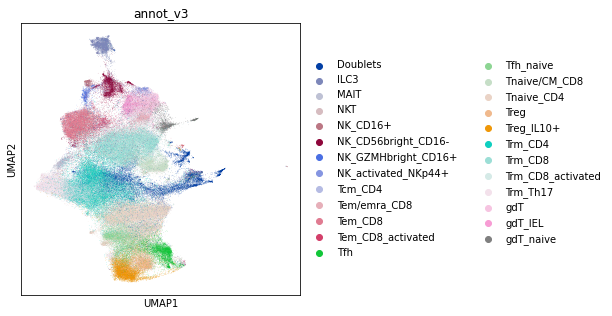

In [37]:
sc.pl.umap(adata,color='annot_v3')

In [41]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

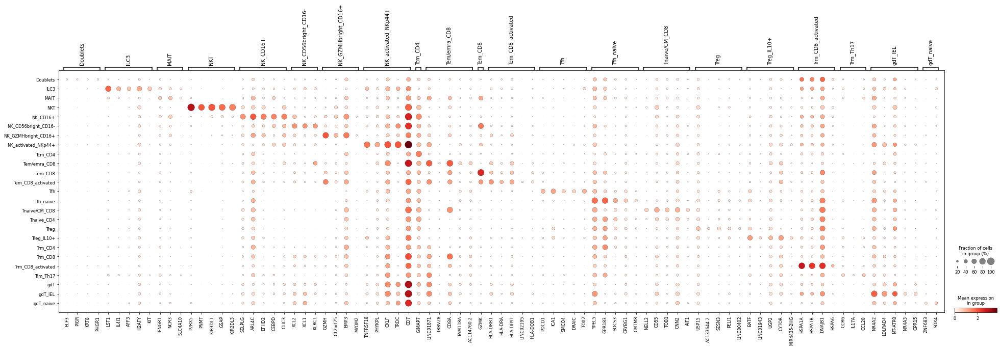

In [24]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="annot_v3")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='annot_v3', mks=mks)

In [38]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/T.hvg5000_noCC.scvi_output.annotv3.22021206.h5ad')

In [39]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [40]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/T_annot_v3.csv')

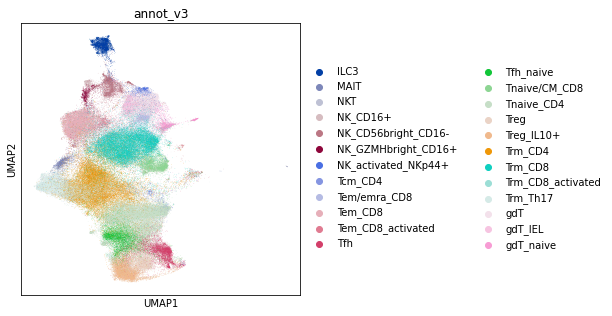

In [41]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [42]:
adata_nodoublets.X.max()

8.673899

In [43]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [44]:
adata_nodoublets.X.max()

3721.0

In [45]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/T.raw.annotv3.nodoublets.22021206.h5ad')

### Export UMAPs and gene lists for GoAnnotateMe

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/no_doublets/T.hvg5000_noCC.scvi_output.annotv3.nodoublets.22021208.h5ad')

In [161]:
adata.uns["annot_v3_colors"] = ['#477ff7', #ILC3
'#21b796', #MAIT
'#7ca38f', #NKT
'#0c1e0e',#NK_CD16+
'#3f8c08', #NK CD56bright cd16-
'#48d130', #NK GZMHbright CD16+
'#c3f26d', #NK activated NKp44
'#8107ed',#Tcm CD4
'#5ac4e8',#Tem/emra cd8
'#256b87',#Tem CD8
'#71fcfa',#Tem CD8 activated
'#5e0b30',#Tfh
'#5e3c55',#tfh naive
'#5ca4ce',#t naive/CM Cd8
'#9d8ed1',#Tnaive_Cd4
'#f98261',#treg
'#e5c510',#treg il10
'#71357f',#trm cd4
'#2844c1',#trm cd8
'#2b7791',#trm cd8 activated
'#1e093f',#trm th17
'#e363f2',#gdt
'#fca7cf', #gdt IEL
'#b40fc6']#gdt naive

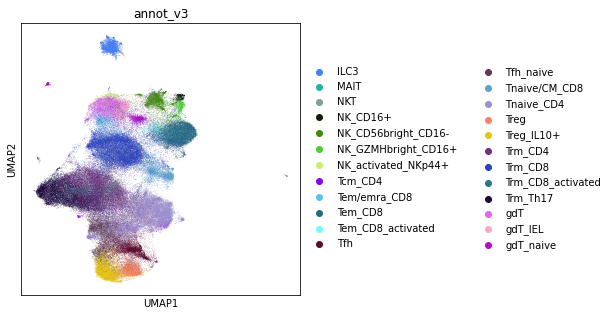

In [162]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='annot_v3')

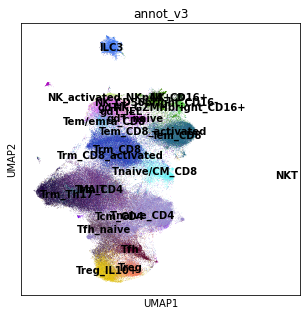

In [81]:
sc.pl.umap(adata,color='annot_v3',legend_loc='on data')

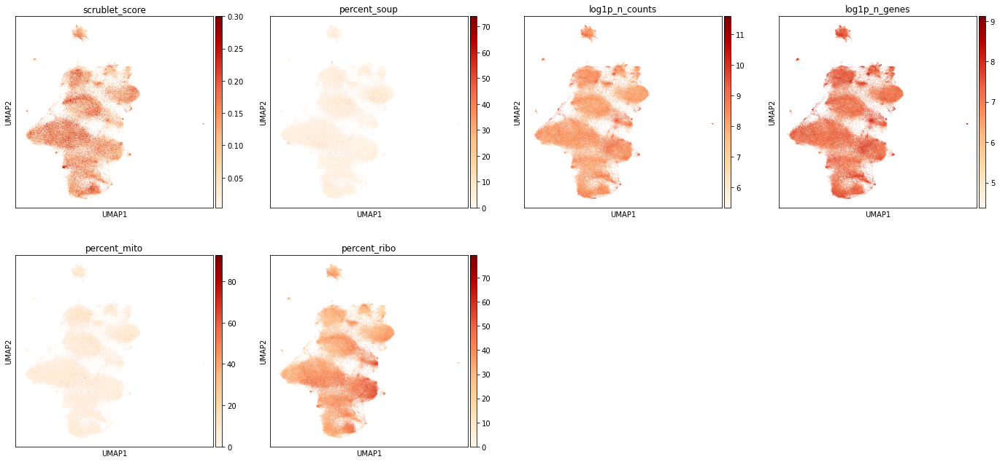

In [32]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

In [84]:
adata.X.max()

3721.0

In [85]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)
adata.X.max()

8.673899

In [86]:
sc.tl.rank_genes_groups(adata,groupby='annot_v3',n_genes=100,method='wilcoxon')

In [87]:
sc.tl.rank_genes_groups(adata,groupby='annot_v3',n_genes=100,method='wilcoxon')
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
for group in groups for key in ['names','logfoldchanges','pvals','pvals_adj']})
df.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/GoAnnotateMe/Top100DEG/T_top100DEG.csv')

In [88]:
df

,ILC3_n,ILC3_l,ILC3_p,MAIT_n,MAIT_l,MAIT_p,NKT_n,NKT_l,NKT_p,NK_CD16+_n,...,Trm_Th17_p,gdT_n,gdT_l,gdT_p,gdT_IEL_n,gdT_IEL_l,gdT_IEL_p,gdT_naive_n,gdT_naive_l,gdT_naive_p
0,LST1,5.688384,0.000000e+00,KLRB1,2.702289,0.000000e+00,P2RX5,7.698942,1.933087e-99,NKG7,...,0.000000e+00,CCL5,3.585649,0.000000e+00,CCL5,3.415473,0.000000e+00,CD7,1.530938,0.000000e+00
1,TYROBP,3.968870,0.000000e+00,S100A4,1.804659,0.000000e+00,CMC1,5.993176,2.584148e-97,TYROBP,...,0.000000e+00,CD7,2.455444,0.000000e+00,CD7,2.270511,0.000000e+00,TRDC,3.326979,0.000000e+00
2,AREG,3.996819,0.000000e+00,DUSP2,2.012754,3.318889e-276,MTRNR2L8,6.797585,2.945050e-92,PRF1,...,0.000000e+00,GZMA,3.938972,0.000000e+00,KLRC2,4.592839,0.000000e+00,XCL1,2.830358,0.000000e+00
3,LINC00299,5.863305,0.000000e+00,CCL4,2.656234,7.765651e-256,KLRC2,5.792394,1.517116e-87,GNLY,...,0.000000e+00,HOPX,3.070633,0.000000e+00,KIR2DL4,4.475716,0.000000e+00,PFN1,0.708670,1.321275e-200
4,NFKBIA,2.147234,0.000000e+00,NFKBIA,1.677822,9.213494e-228,KIR3DL1,10.032946,8.018601e-86,FCER1G,...,0.000000e+00,KLRC2,4.366892,0.000000e+00,KLRD1,2.790975,0.000000e+00,LEF1,1.990024,4.082471e-199
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,PTGDR,2.734172,1.083467e-136,GBP2,0.810786,6.483203e-17,IKZF2,3.805045,1.040495e-32,GNAI2,...,1.616350e-123,CD3D,0.548981,6.638193e-205,LCP1,0.989444,6.961255e-168,MYL6,0.324033,1.339524e-35
96,AC253572.2,2.409519,2.333506e-135,PPP2R5C,0.462361,1.615396e-16,TGFB1,2.509292,4.525000e-32,TPST2,...,2.344724e-121,FKBP1A,0.969667,1.310760e-203,CHCHD10,1.326900,1.364722e-166,SEPTIN9,0.522986,2.798225e-35
97,SPRY1,1.530699,8.853631e-132,KDM6B,0.961257,2.113517e-16,KIR3DL2,5.298977,4.897888e-32,ACTN4,...,4.875082e-120,MT-ATP6,0.470555,1.593506e-197,CD3E,0.703770,1.867114e-166,C9orf16,0.502638,3.605412e-35
98,CTSH,3.167462,6.096283e-131,PARP8,0.721958,2.960526e-16,DCAF7,3.010792,5.302488e-32,PXN,...,3.988076e-119,LGALS1,1.285339,1.022019e-195,VIM,0.916419,6.951990e-166,GUK1,0.464042,3.885006e-35


In [92]:
print(df.head(10))

      ILC3_n    ILC3_l  ILC3_p  MAIT_n    MAIT_l         MAIT_p      NKT_n  \
0       LST1  5.688384     0.0   KLRB1  2.702289   0.000000e+00      P2RX5   
1     TYROBP  3.968870     0.0  S100A4  1.804659   0.000000e+00       CMC1   
2       AREG  3.996819     0.0   DUSP2  2.012754  3.318889e-276   MTRNR2L8   
3  LINC00299  5.863305     0.0    CCL4  2.656234  7.765651e-256      KLRC2   
4     NFKBIA  2.147234     0.0  NFKBIA  1.677822  9.213494e-228    KIR3DL1   
5        LTB  2.344863     0.0   KLRG1  2.998478  2.202284e-206      SPON2   
6      IL4I1  5.181268     0.0    RORA  1.743454  4.134677e-203     FCGR3A   
7       IL7R  1.863429     0.0    NCR3  3.498221  2.256774e-188  LINC02446   
8      KRT86  5.210339     0.0    GZMK  2.274178  3.989280e-177    KIR2DL3   
9        ID2  1.956031     0.0     LTB  1.428595  2.467824e-165       GSAP   

       NKT_l         NKT_p NK_CD16+_n  ...  Trm_Th17_p    gdT_n     gdT_l  \
0   7.698942  1.933087e-99       NKG7  ...         0.0     CCL5 

In [108]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

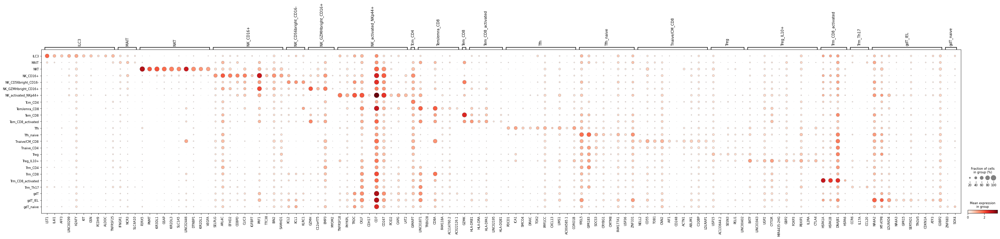

In [109]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="annot_v3")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='annot_v3', mks=mks, n_genes=10)

In [110]:
mks

,top_frac_group,top_frac,frac_diff,max_frac_diff,top_mean_group,top_mean,mean_diff,max_mean_diff
LST1,ILC3,0.735571,0.492304,0.547214,ILC3,0.415872,0.317376,0.341132
IL4I1,ILC3,0.506841,0.356729,0.370437,ILC3,0.241063,0.182586,0.183245
AFF3,ILC3,0.448055,0.335131,0.364535,ILC3,0.208643,0.168156,0.177315
LINC00299,ILC3,0.553228,0.310217,0.316335,ILC3,0.256536,0.167568,0.170558
H2AFY,ILC3,0.602180,0.216216,0.246266,ILC3,0.294150,0.163738,0.168042
...,...,...,...,...,...,...,...,...
SDCBP,gdT_IEL,0.514530,0.055730,0.112242,gdT_IEL,0.196917,0.011234,0.017525
TIPARP,gdT_IEL,0.405372,0.056505,0.169889,gdT_IEL,0.165511,0.007253,0.073406
IDS,gdT_IEL,0.593162,0.054096,0.112801,gdT_IEL,0.232465,0.001903,0.024103
ZNF683,gdT_naive,0.232414,0.135944,0.138217,gdT_naive,0.101340,0.061113,0.061247


In [164]:
sc.tl.leiden(adata, resolution = 1, neighbors_key="neighbors_scvi")

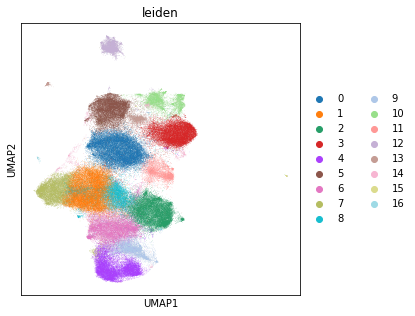

In [187]:
sc.pl.umap(adata,color=['leiden'])

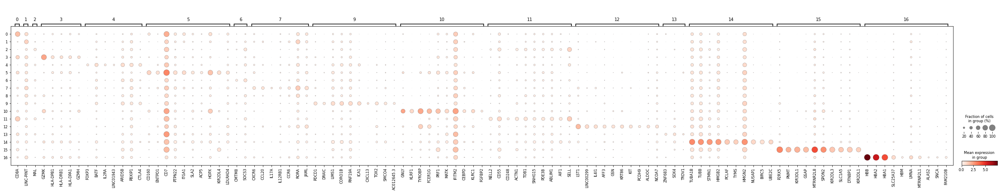

In [188]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks, n_genes=10)

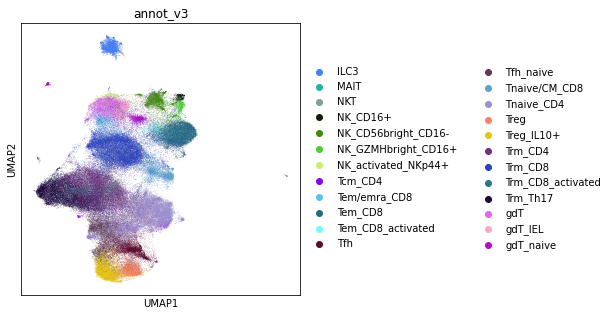

In [172]:
sc.pl.umap(adata,color=['annot_v3'])

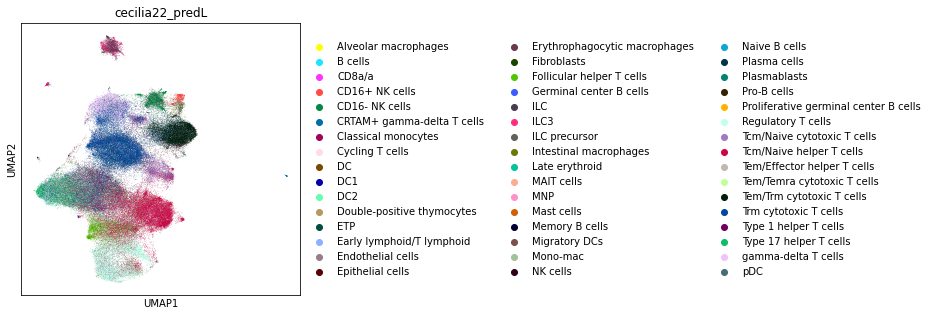

In [173]:
sc.pl.umap(adata,color=['cecilia22_predL'])

In [174]:
list(adata.obs.cecilia22_predL.unique())

['Epithelial cells',
 'Tem/Trm cytotoxic T cells',
 'Tem/Effector helper T cells',
 'Tcm/Naive helper T cells',
 'Regulatory T cells',
 'ILC3',
 'Tcm/Naive cytotoxic T cells',
 'CD16- NK cells',
 'CD16+ NK cells',
 'Tem/Temra cytotoxic T cells',
 'CRTAM+ gamma-delta T cells',
 'Plasmablasts',
 'MAIT cells',
 'Follicular helper T cells',
 'Naive B cells',
 'Memory B cells',
 'Proliferative germinal center B cells',
 'Classical monocytes',
 'CD8a/a',
 'Double-positive thymocytes',
 'Trm cytotoxic T cells',
 'Type 17 helper T cells',
 'gamma-delta T cells',
 'Migratory DCs',
 'Plasma cells',
 'NK cells',
 'Late erythroid',
 'Type 1 helper T cells',
 'Erythrophagocytic macrophages',
 'Alveolar macrophages',
 'ILC precursor',
 'Mono-mac',
 'DC2',
 'ILC',
 'Pro-B cells',
 'Mast cells',
 'Germinal center B cells',
 'ETP',
 'Fibroblasts',
 'Intestinal macrophages',
 'Endothelial cells',
 'DC1',
 'Early lymphoid/T lymphoid',
 'pDC',
 'Cycling T cells',
 'MNP',
 'B cells',
 'DC']

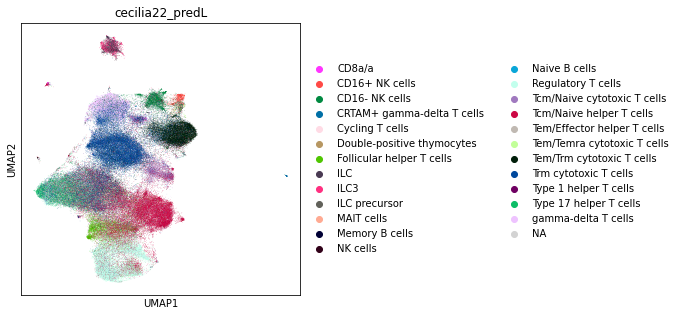

In [175]:
sc.pl.umap(adata,color='cecilia22_predL',groups=[
 'Tem/Trm cytotoxic T cells',
 'Tem/Effector helper T cells',
 'Tcm/Naive helper T cells',
 'Regulatory T cells',
 'ILC3',
 'Tcm/Naive cytotoxic T cells',
 'CD16- NK cells',
 'CD16+ NK cells',
 'Tem/Temra cytotoxic T cells',
 'CRTAM+ gamma-delta T cells',
 'MAIT cells',
 'Follicular helper T cells',
 'Naive B cells',
 'Memory B cells',
 'CD8a/a',
 'Double-positive thymocytes',
 'Trm cytotoxic T cells',
 'Type 17 helper T cells',
 'gamma-delta T cells',
 'NK cells',
 'Type 1 helper T cells',
 'ILC precursor',
 'ILC',
 'Cycling T cells',])

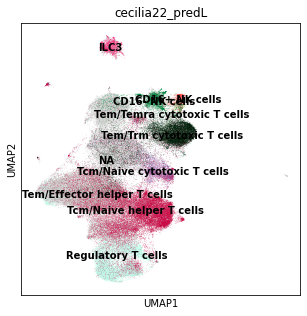

In [179]:
sc.pl.umap(adata,color='cecilia22_predL',groups=[
 'Tem/Trm cytotoxic T cells',
 'Tem/Effector helper T cells',
 'Tcm/Naive helper T cells',
 'Regulatory T cells',
 'ILC3',
 'Tcm/Naive cytotoxic T cells',
 'CD16- NK cells',
 'CD16+ NK cells',
 'Tem/Temra cytotoxic T cells',
],legend_loc='on data')

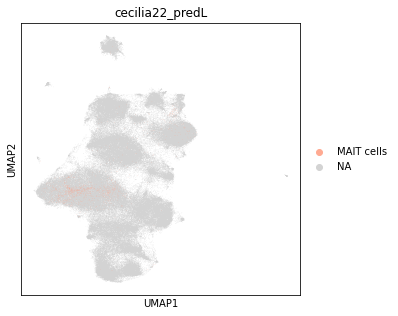

In [222]:
sc.pl.umap(adata,color='cecilia22_predL',groups=['MAIT cells'])

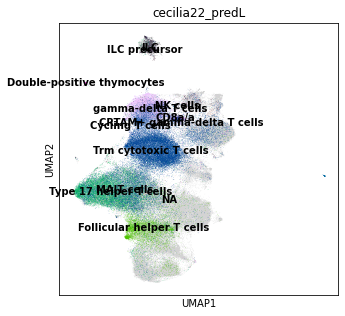

In [182]:
 sc.pl.umap(adata,color='cecilia22_predL',groups=['CRTAM+ gamma-delta T cells',
 'MAIT cells',
 'Follicular helper T cells',
 'CD8a/a',
 'Double-positive thymocytes',
 'Trm cytotoxic T cells',
 'Type 17 helper T cells',
 'gamma-delta T cells',
 'NK cells',
 
 'ILC precursor',
 'ILC',
 'Cycling T cells',
],legend_loc='on data')

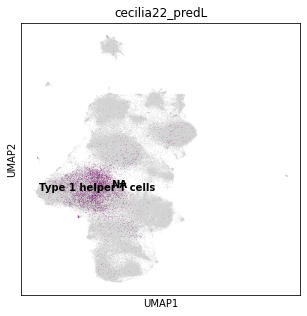

In [183]:
 sc.pl.umap(adata,color='cecilia22_predL',groups=['Type 1 helper T cells'
],legend_loc='on data')

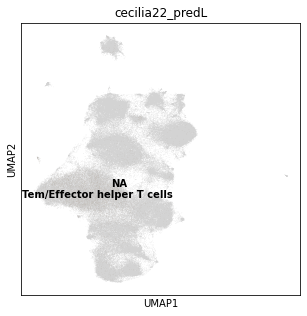

In [184]:
 sc.pl.umap(adata,color='cecilia22_predL',groups=['Tem/Effector helper T cells'
],legend_loc='on data')

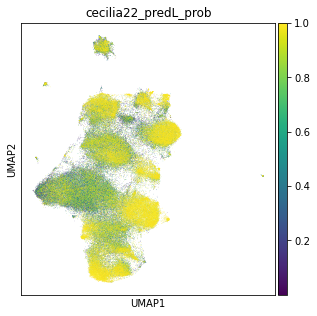

In [186]:
sc.pl.umap(adata,color='cecilia22_predL_prob')

In [166]:
pd.crosstab(adata.obs.annot_v3,adata.obs.leiden)

leiden,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
annot_v3,,,,,,,,,,,,,,,,,
ILC3,1,28,0,1,1,32,1,70,10,4,61,0,4430,29,5,0,5
MAIT,35,203,6,100,17,18,10,181,1611,15,79,4,15,3,1,0,4
NKT,0,0,0,0,0,2,0,0,0,0,1,0,1,0,2,165,0
NK_CD16+,2,0,0,14,0,21,0,0,4,0,967,0,0,1,21,0,0
NK_CD56bright_CD16-,90,8,4,702,1,339,0,3,84,11,4045,4,66,47,174,1,4
NK_GZMHbright_CD16+,11,0,1,224,0,0,0,0,25,0,1026,1,0,0,9,0,5
NK_activated_NKp44+,0,0,0,1,0,871,0,2,0,0,29,0,7,1,18,0,1
Tcm_CD4,34,78,252,28,24,33,79,43,323,39,3,40,0,1,11,0,2
Tem/emra_CD8,431,8,1,101,1,2014,3,45,2,4,3,0,0,1,33,0,0


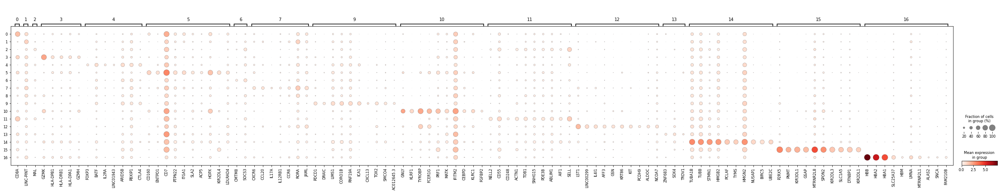

In [167]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks, n_genes=10)

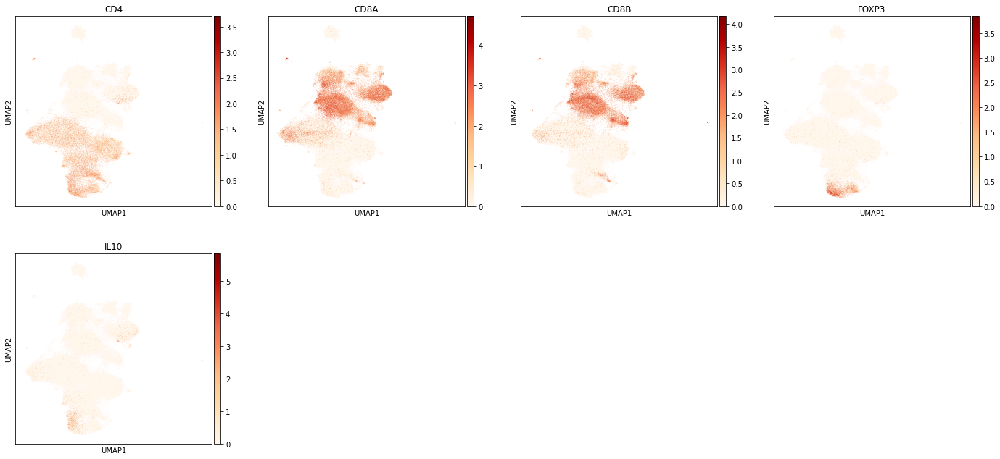

In [181]:
sc.pl.umap(adata,color=['CD4','CD8A','CD8B','FOXP3','IL10'],cmap='OrRd')

In [191]:
list(adata.obs.annot_v3.unique())

['Treg_IL10+',
 'Tem_CD8',
 'Trm_Th17',
 'Trm_CD4',
 'NK_GZMHbright_CD16+',
 'Trm_CD8',
 'Tnaive_CD4',
 'Tem_CD8_activated',
 'ILC3',
 'Tfh_naive',
 'gdT',
 'Tnaive/CM_CD8',
 'NK_CD16+',
 'Tcm_CD4',
 'NK_CD56bright_CD16-',
 'NKT',
 'Treg',
 'Trm_CD8_activated',
 'Tem/emra_CD8',
 'MAIT',
 'gdT_naive',
 'NK_activated_NKp44+',
 'Tfh',
 'gdT_IEL']

In [192]:
adata

AnnData object with n_obs × n_vars = 177206 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

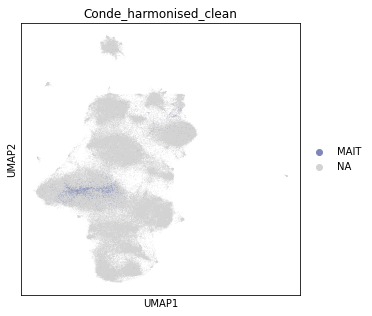

In [220]:
sc.pl.umap(adata,color='Conde_harmonised_clean',groups='MAIT')

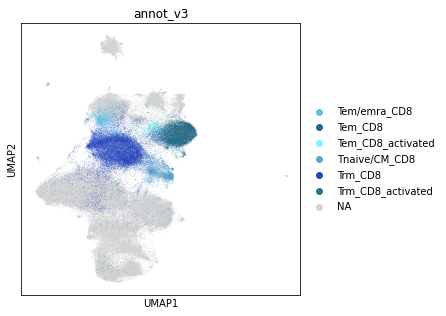

In [203]:
sc.pl.umap(adata,color='annot_v3',groups=['Trm_CD8_activated',
 'Tem/emra_CD8','Tem_CD8','Tem_CD8_activated','Tnaive/CM_CD8','Trm_CD8'])

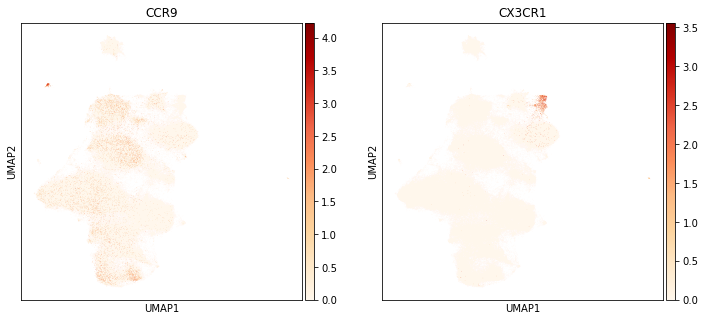

In [204]:
sc.pl.umap(adata,color=['CCR9','CX3CR1'],cmap='OrRd')

In [198]:
adata.obs.annot_v3.value_counts()

Tnaive_CD4             26268
Trm_CD4                24015
Trm_CD8                23143
Trm_Th17               17074
Tem_CD8                14133
Treg_IL10+              8726
Tfh_naive               7500
gdT                     7091
Tnaive/CM_CD8           6549
Tfh                     6438
Treg                    6172
NK_CD56bright_CD16-     5583
ILC3                    4678
gdT_IEL                 4095
gdT_naive               4023
Tem/emra_CD8            2647
MAIT                    2302
Tem_CD8_activated       2011
NK_GZMHbright_CD16+     1302
NK_CD16+                1030
Tcm_CD4                  990
NK_activated_NKp44+      930
Trm_CD8_activated        335
NKT                      171
Name: annot_v3, dtype: int64

In [205]:
adata.obs['annot_v3_T_simple'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {
 'Tem_CD8':'Trm/em_CD8',
 'Tnaive_CD4':'Tcm/naive_CD4',
 'Tem_CD8_activated':'Trm/em_CD8',
 'Tfh_naive':'Tfh',
 'Tcm_CD4':'Tcm/naive_CD4'
    }.get(x, x))
    .astype("category")
)

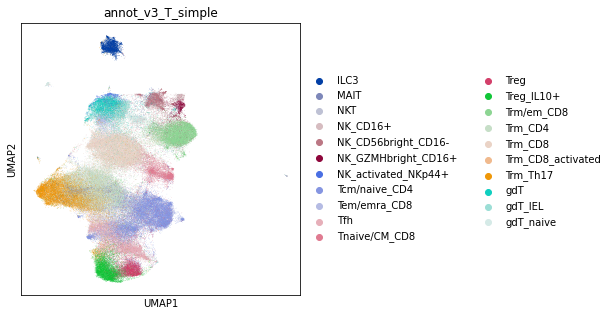

In [206]:
sc.pl.umap(adata,color='annot_v3_T_simple')

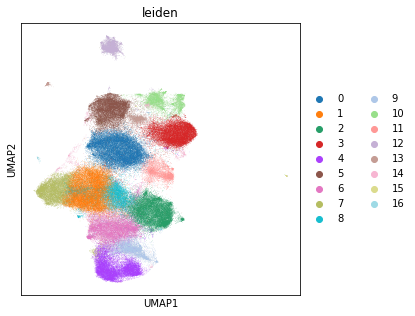

In [214]:
sc.pl.umap(adata,color='leiden')

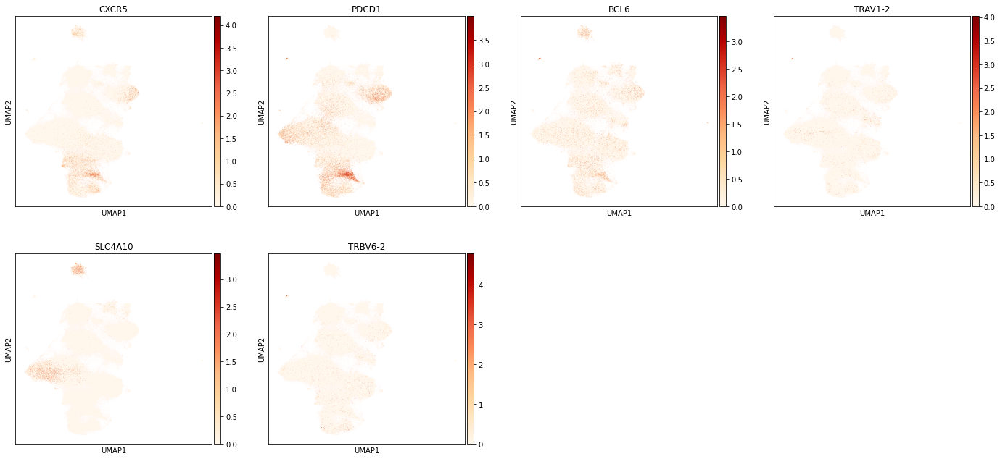

In [219]:
sc.pl.umap(adata,color=['CXCR5','PDCD1','BCL6','TRAV1-2','SLC4A10','TRBV6-2'],cmap='OrRd')

In [261]:
new_cluster_names = [
    'Trm_CD8','Trm_CD4', #0,1
    'Tnaive/cm_CD4','Trm/em_CD8',#2,3
    'Treg','gdT',#4,5
    'Tfh_naive','Trm_Th17',#6,7
    'Tnaive/cm_CD4','Tfh',#8,9
    'NK','Tnaive/cm_CD8',#10,11
    'ILC3','gdT_naive',#12,13
    'T/NK_cycling','NKT',#14,15
    'Doublet'
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v4'] = [conv[x] for x in adata.obs['leiden']]

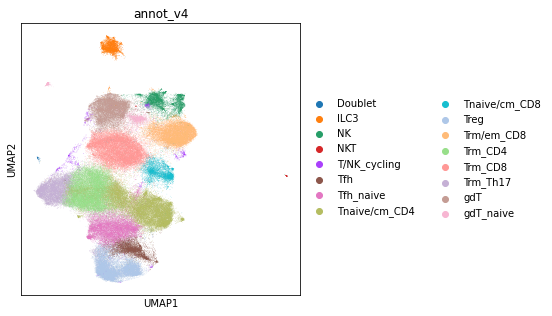

In [262]:
sc.pl.umap(adata,color='annot_v4')

In [263]:
nk = adata[adata.obs.annot_v4.isin(['NK'])].copy()

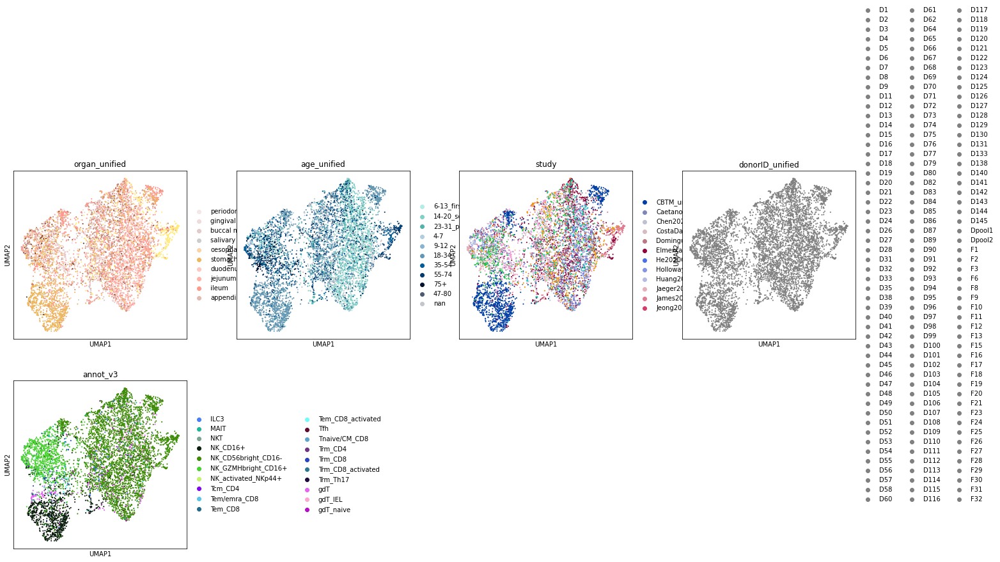

In [264]:
sc.pp.neighbors(
        nk,
            use_rep="X_scvi",
            n_pcs=nk.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(nk, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(nk, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

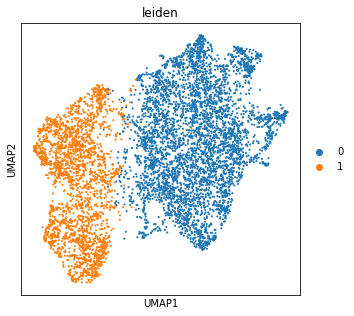

In [265]:
sc.tl.leiden(nk, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(nk, color=['leiden'])

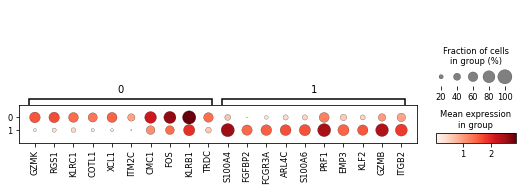

In [266]:
adata.raw = adata.copy()
mkst = calc_marker_stats(nk, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(nk, groupby='leiden', mks=mks, n_genes=10)

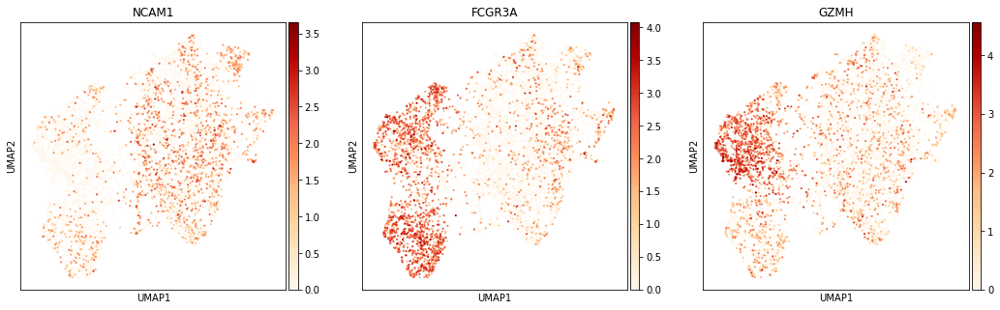

In [267]:
sc.pl.umap(nk,color=['NCAM1','FCGR3A','GZMH'],cmap='OrRd')

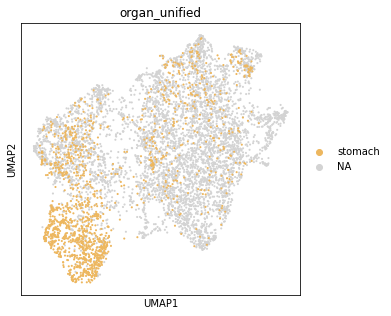

In [268]:
sc.pl.umap(nk,color='organ_unified',groups='stomach')

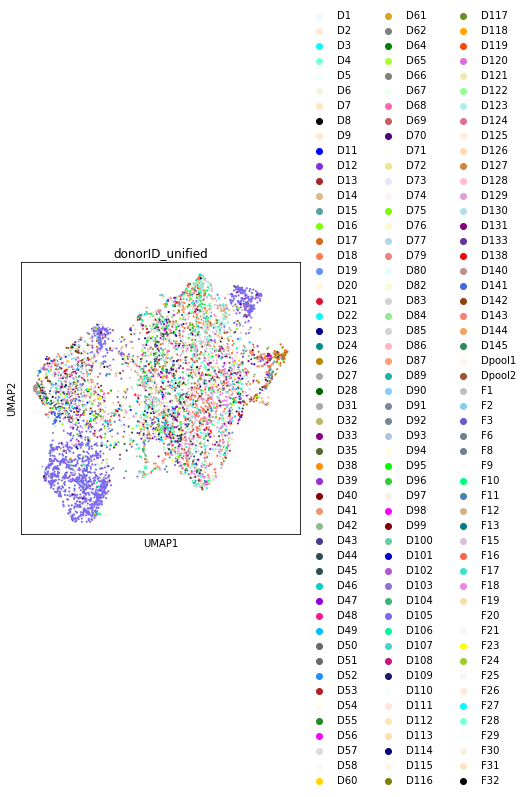

In [345]:
sc.pl.umap(nk,color='donorID_unified',palette=list(matplotlib.colors.CSS4_COLORS.values()))

In [269]:
new_cluster_names = [
    'NK_CD56bright','NK_CD16' #0,1
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

nk.obs['annot_v4'] = [conv[x] for x in nk.obs['leiden']]

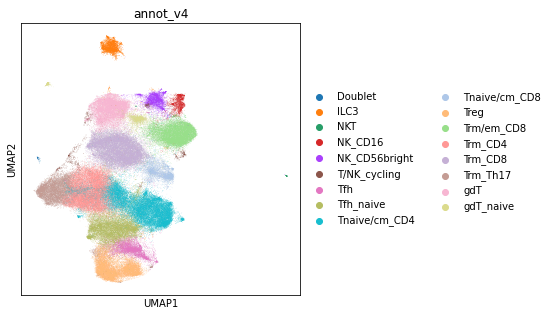

In [270]:
ON = {O:N for O,N in zip(nk.obs_names,nk.obs["annot_v4"])}
adata.obs["annot_v4"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v4"])]
sc.pl.umap(adata,color='annot_v4')

In [271]:
treg = adata[adata.obs.annot_v4.isin(['Treg'])].copy()

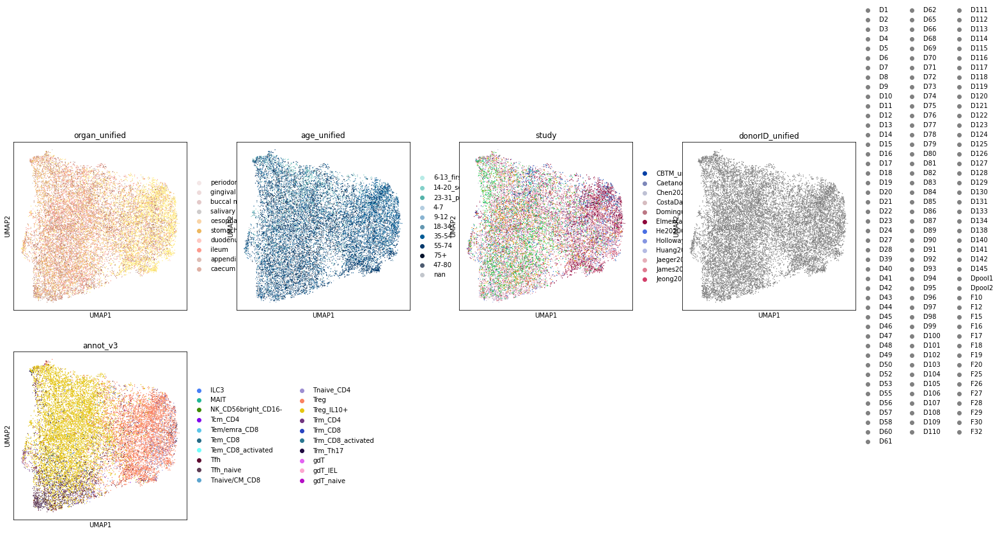

In [272]:
sc.pp.neighbors(
        treg,
            use_rep="X_scvi",
            n_pcs=treg.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(treg, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(treg, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

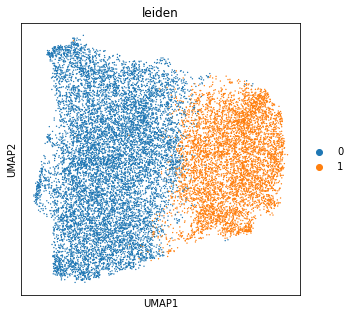

In [273]:
sc.tl.leiden(treg, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(treg, color=['leiden'])

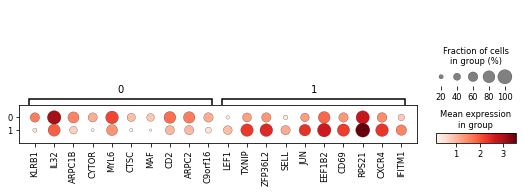

In [274]:
adata.raw = adata.copy()
mkst = calc_marker_stats(treg, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(treg, groupby='leiden', mks=mks, n_genes=10)

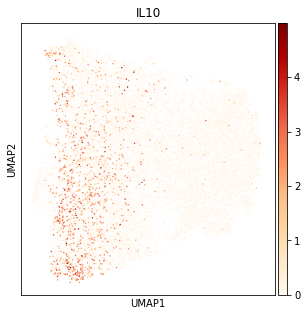

In [275]:
sc.pl.umap(treg,color='IL10',cmap='OrRd')

In [276]:
new_cluster_names = [
    'Treg_IL10','Treg' #0,1
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

treg.obs['annot_v4'] = [conv[x] for x in treg.obs['leiden']]

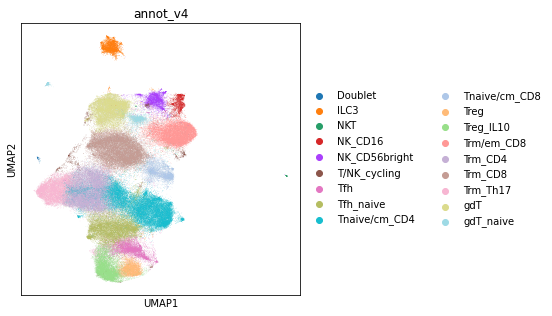

In [277]:
ON = {O:N for O,N in zip(treg.obs_names,treg.obs["annot_v4"])}
adata.obs["annot_v4"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v4"])]
sc.pl.umap(adata,color='annot_v4')

In [278]:
cd4 = adata[adata.obs.annot_v4.isin(['Tfh','Tfh_naive','Tnaive/cm_CD4','Trm_CD4','Trm_Th17'])].copy()

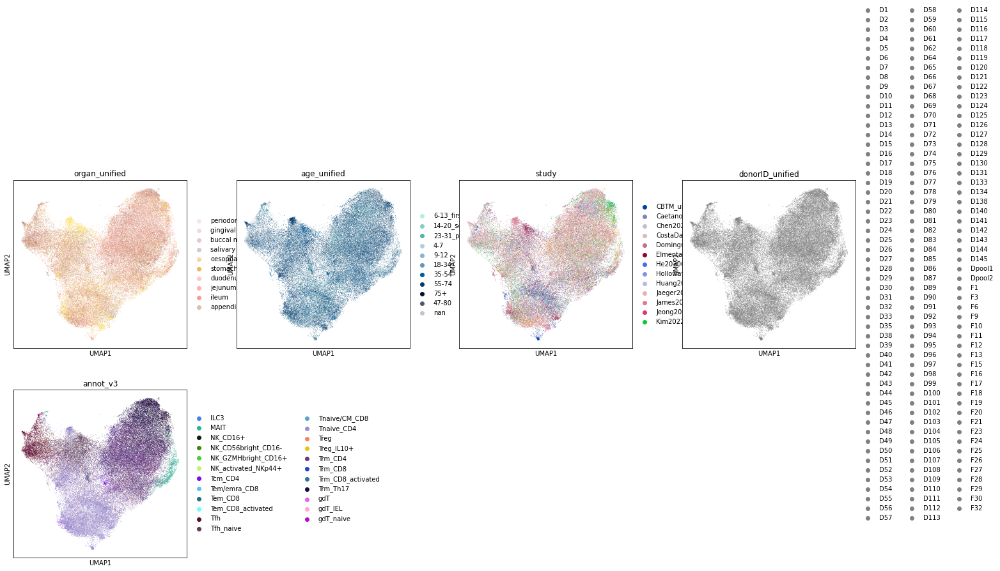

In [279]:
sc.pp.neighbors(
        cd4,
            use_rep="X_scvi",
            n_pcs=cd4.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cd4, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cd4, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

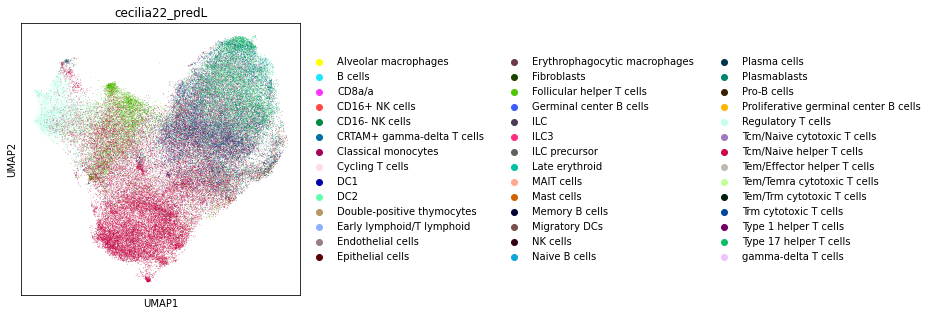

In [287]:
sc.pl.umap(cd4,color='cecilia22_predL')

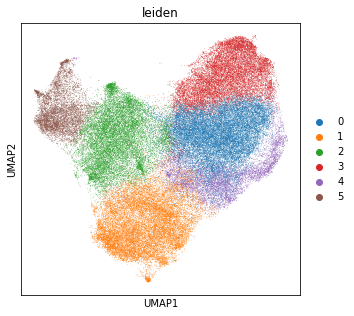

In [283]:
sc.tl.leiden(cd4, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(cd4, color=['leiden'])

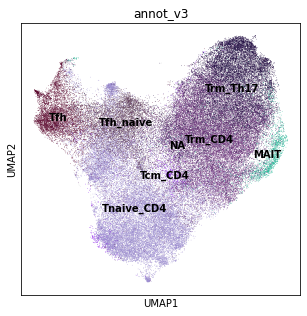

In [293]:
sc.pl.umap(cd4,color='annot_v3',groups=['Tcm_CD4','Tfh','Tfh_naive','Trm_CD4','Tnaive_CD4','MAIT','Trm_Th17'],legend_loc='on data')

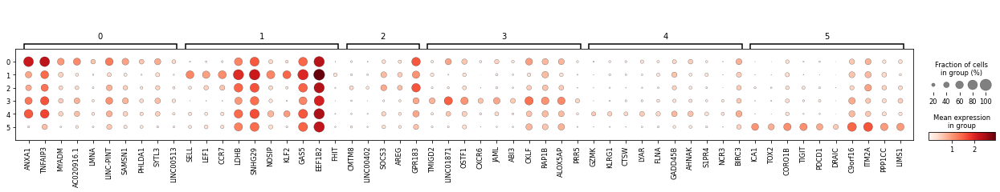

In [284]:
adata.raw = adata.copy()
mkst = calc_marker_stats(cd4, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(cd4, groupby='leiden', mks=mks, n_genes=10)

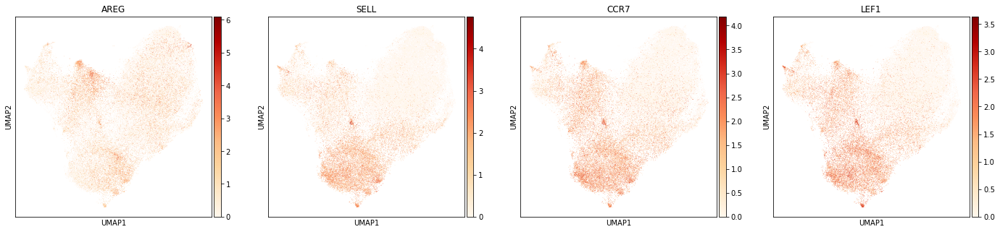

In [296]:
sc.pl.umap(cd4,color=['AREG','SELL','CCR7','LEF1'],cmap='OrRd')

In [297]:
new_cluster_names = [
    'Trm_CD4','Tnaive/cm_CD4', #0,1
    'Tnaive/cm_CD4','Trm_Th17', #2,3
    'MAIT','Tfh'#4,5
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cd4.obs['annot_v4'] = [conv[x] for x in cd4.obs['leiden']]

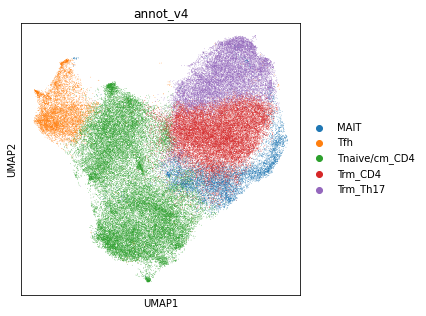

In [298]:
sc.pl.umap(cd4,color='annot_v4')

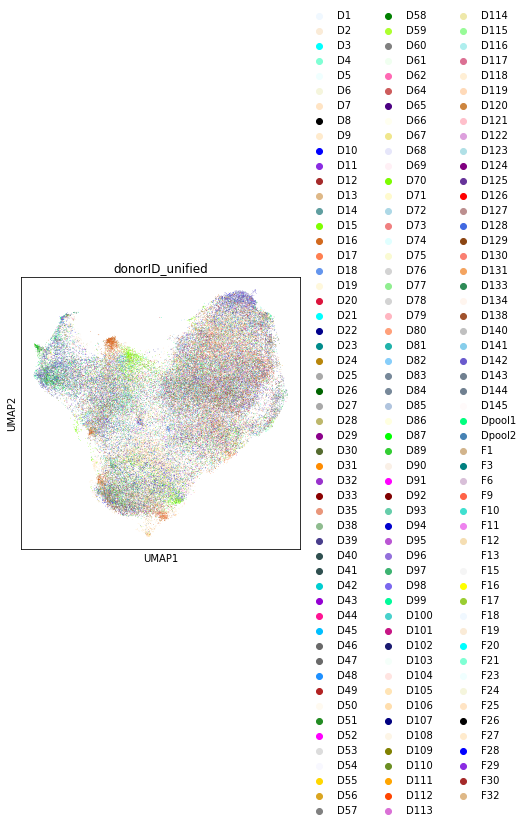

In [344]:
sc.pl.umap(cd4,color='donorID_unified',palette=list(matplotlib.colors.CSS4_COLORS.values()))

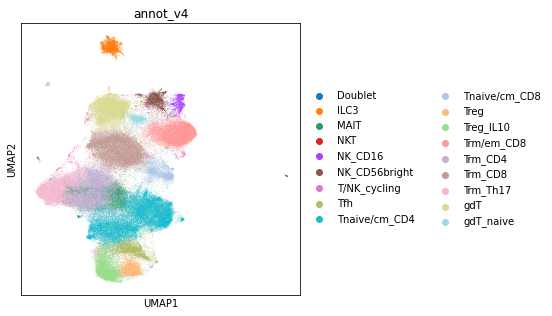

In [299]:
ON = {O:N for O,N in zip(cd4.obs_names,cd4.obs["annot_v4"])}
adata.obs["annot_v4"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v4"])]
sc.pl.umap(adata,color='annot_v4')

In [300]:
cd4a = adata[adata.obs.annot_v4.isin(['MAIT','Tnaive/cm_CD4'])].copy()

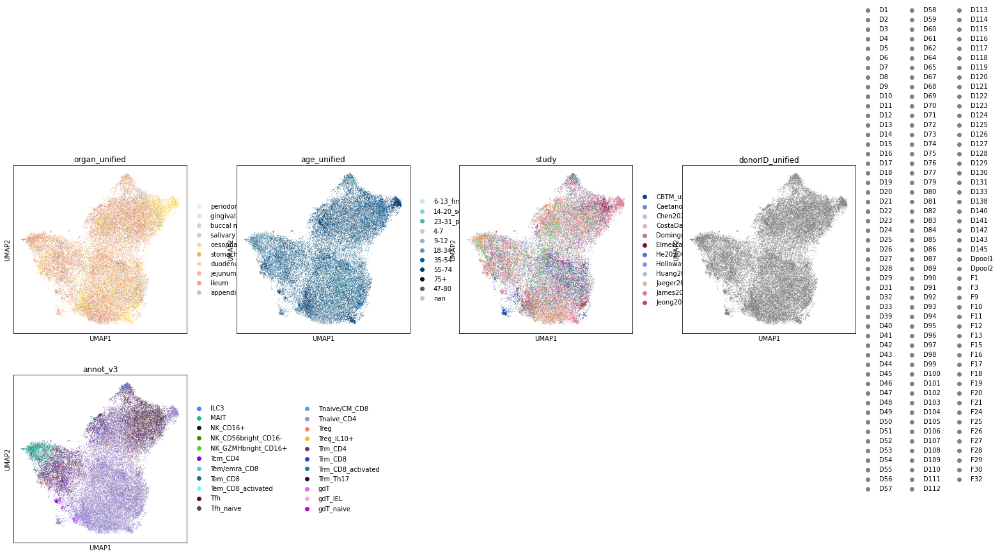

In [301]:
sc.pp.neighbors(
        cd4a,
            use_rep="X_scvi",
            n_pcs=cd4a.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cd4a, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cd4a, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

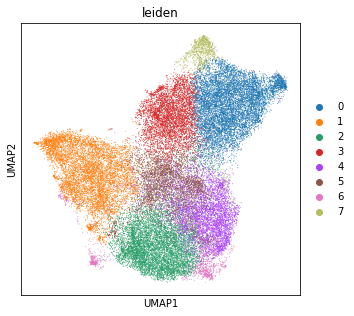

In [315]:
sc.tl.leiden(cd4a, resolution = 0.6, neighbors_key="neighbors_scvi")
sc.pl.umap(cd4a, color=['leiden'])

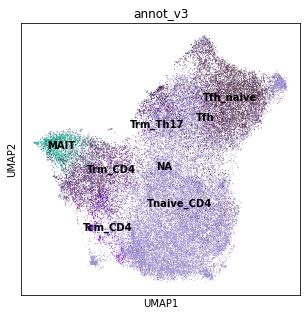

In [308]:
sc.pl.umap(cd4a,color='annot_v3',groups=['Tcm_CD4','Tfh','Tfh_naive','Trm_CD4','Tnaive_CD4','MAIT','Trm_Th17'],legend_loc='on data')

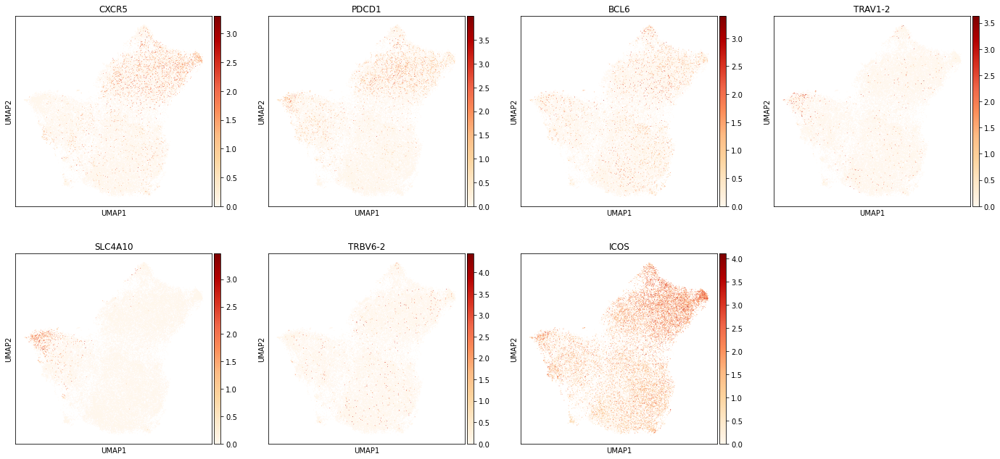

In [312]:
sc.pl.umap(cd4a,color=['CXCR5','PDCD1','BCL6','TRAV1-2','SLC4A10','TRBV6-2','ICOS'],cmap='OrRd')

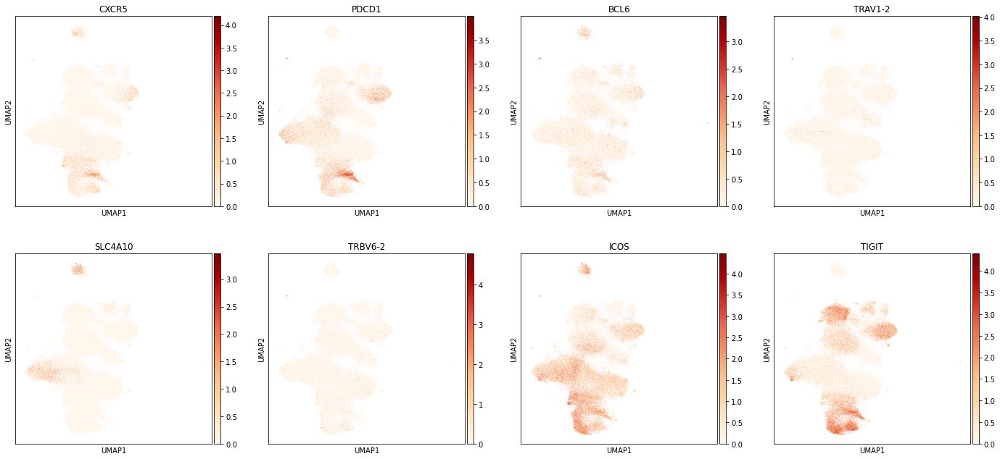

In [318]:
sc.pl.umap(adata,color=['CXCR5','PDCD1','BCL6','TRAV1-2','SLC4A10','TRBV6-2','ICOS','TIGIT'],cmap='OrRd')

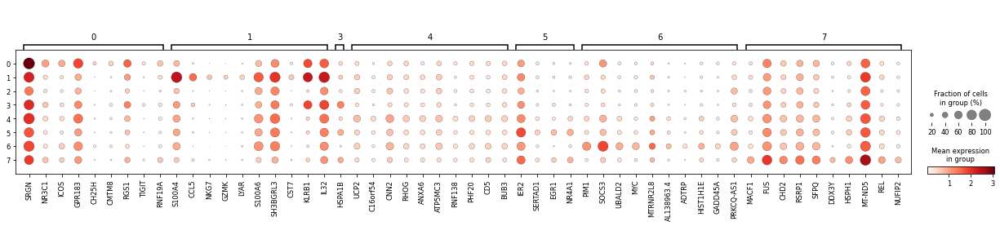

In [316]:
adata.raw = adata.copy()
mkst = calc_marker_stats(cd4a, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(cd4a, groupby='leiden', mks=mks, n_genes=10)

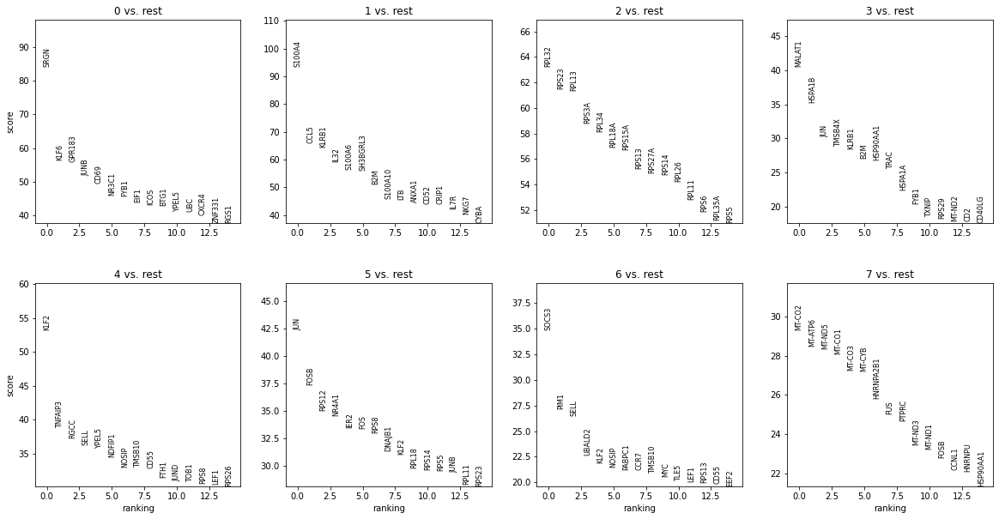

In [317]:
sc.tl.rank_genes_groups(cd4a, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(cd4a, n_genes=15, sharey=False)

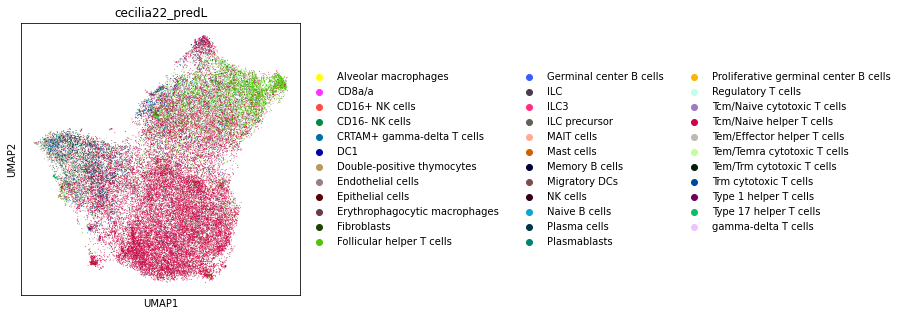

In [319]:
sc.pl.umap(cd4a,color='cecilia22_predL')

In [320]:
new_cluster_names = [
    'Tfh_naive','Trm_CD4', #0,1
    'Tnaive/cm_CD4','Tnaive/cm_CD4', #2,3
    'Tnaive/cm_CD4','Tnaive/cm_CD4',#4,5
    'Tnaive/cm_CD4','Tnaive/cm_CD4'#6,7
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cd4a.obs['annot_v4'] = [conv[x] for x in cd4a.obs['leiden']]

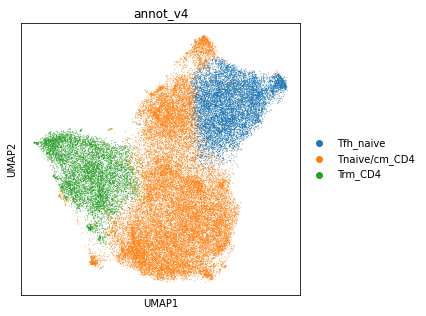

In [321]:
sc.pl.umap(cd4a,color='annot_v4')

In [322]:
cd4b = cd4a[cd4a.obs.annot_v4.isin(['Trm_CD4'])].copy()

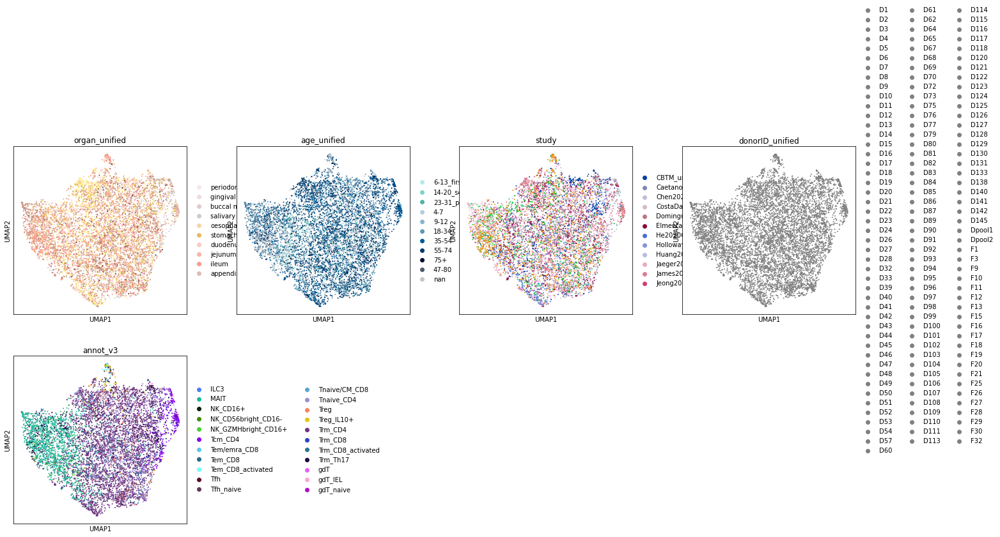

In [323]:
sc.pp.neighbors(
        cd4b,
            use_rep="X_scvi",
            n_pcs=cd4b.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cd4b, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cd4b, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

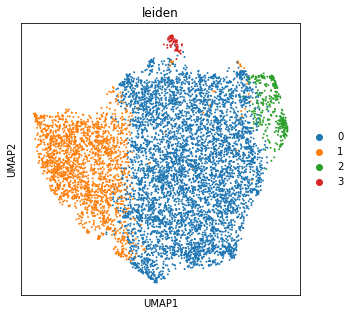

In [326]:
sc.tl.leiden(cd4b, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(cd4b, color=['leiden'])

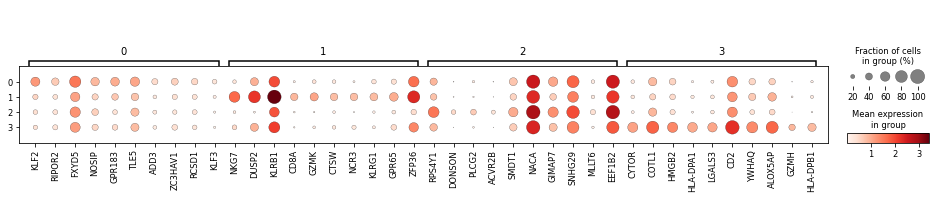

In [327]:
adata.raw = adata.copy()
mkst = calc_marker_stats(cd4b, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(cd4b, groupby='leiden', mks=mks, n_genes=10)

In [328]:
new_cluster_names = [
    'Trm_CD4','MAIT', #0,1
    'Trm_CD4','Trm_CD4' #2,3
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cd4b.obs['annot_v4'] = [conv[x] for x in cd4b.obs['leiden']]

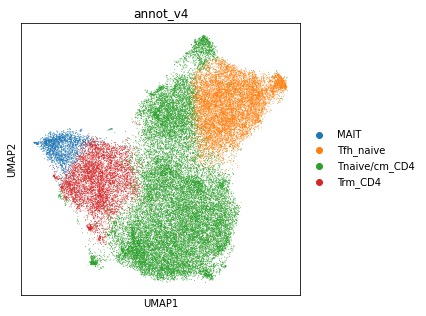

In [329]:
ON = {O:N for O,N in zip(cd4b.obs_names,cd4b.obs["annot_v4"])}
cd4a.obs["annot_v4"] = [ON[O] if O in ON else N for O,N in zip(cd4a.obs_names, cd4a.obs["annot_v4"])]
sc.pl.umap(cd4a,color='annot_v4')

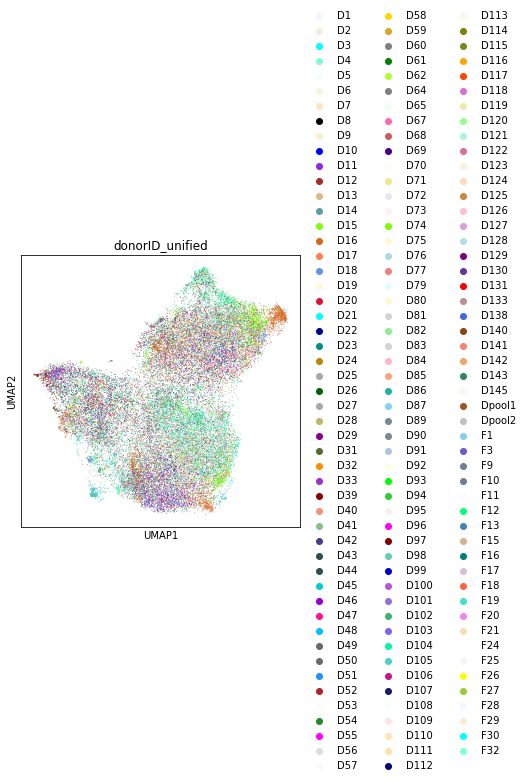

In [343]:
sc.pl.umap(cd4a,color='donorID_unified',palette=list(matplotlib.colors.CSS4_COLORS.values()))

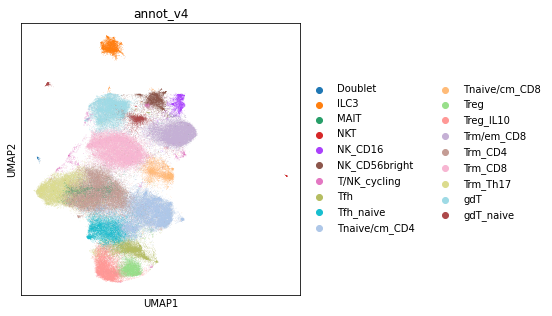

In [330]:
ON = {O:N for O,N in zip(cd4a.obs_names,cd4a.obs["annot_v4"])}
adata.obs["annot_v4"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v4"])]
sc.pl.umap(adata,color='annot_v4')

In [331]:
gdt = adata[adata.obs.annot_v4.isin(['gdT','gdT_naive'])].copy()

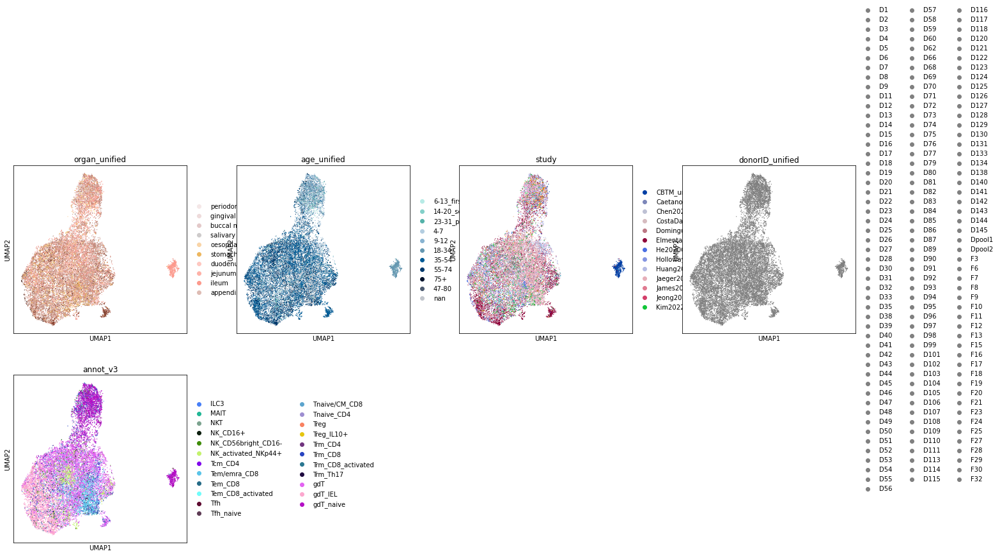

In [332]:
sc.pp.neighbors(
        gdt,
            use_rep="X_scvi",
            n_pcs=gdt.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(gdt, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(gdt, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

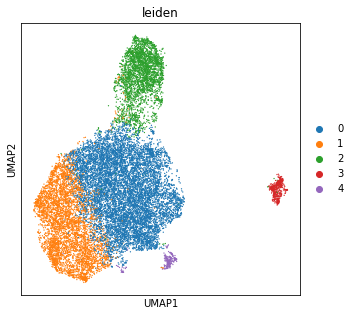

In [333]:
sc.tl.leiden(gdt, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(gdt, color=['leiden'])

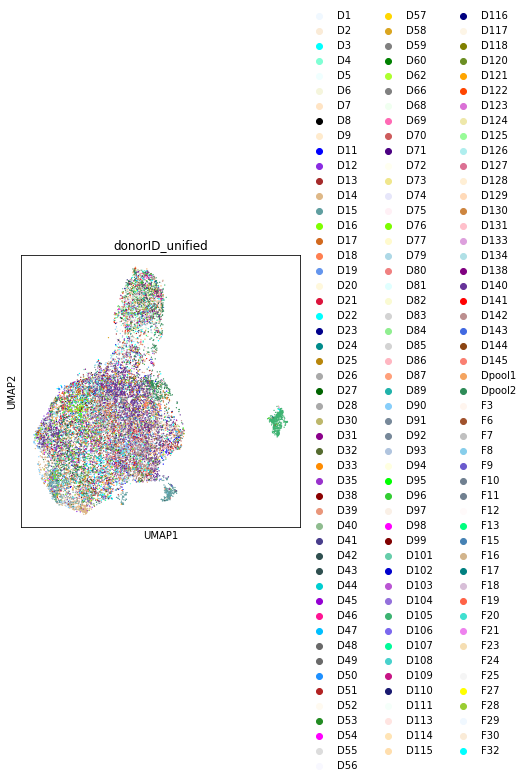

In [335]:
import matplotlib
sc.pl.umap(gdt,color='donorID_unified',palette=list(matplotlib.colors.CSS4_COLORS.values()))

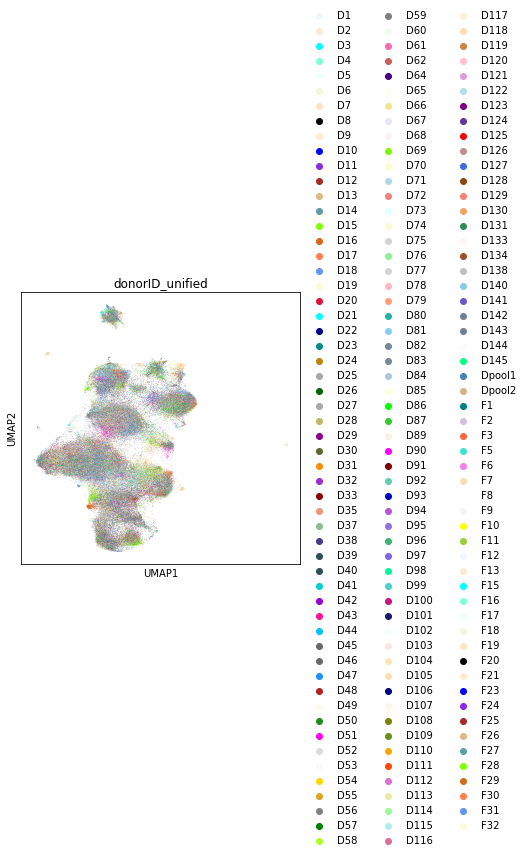

In [338]:
sc.pl.umap(adata,color='donorID_unified',palette=list(matplotlib.colors.CSS4_COLORS.values()))

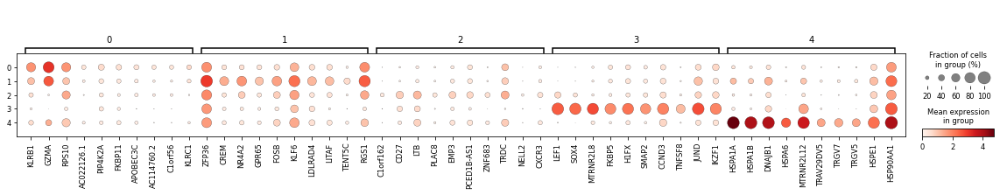

In [336]:
adata.raw = adata.copy()
mkst = calc_marker_stats(gdt, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gdt, groupby='leiden', mks=mks, n_genes=10)

In [339]:
new_cluster_names = [
    'gdT','gdT_IEL', #0,1
    'gdT_naive','Doublets', #2,3
    'Doublets'
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

gdt.obs['annot_v4'] = [conv[x] for x in gdt.obs['leiden']]

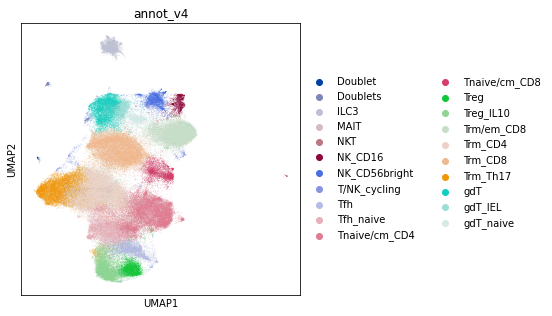

In [340]:
ON = {O:N for O,N in zip(gdt.obs_names,gdt.obs["annot_v4"])}
adata.obs["annot_v4"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v4"])]
sc.pl.umap(adata,color='annot_v4')

In [341]:
adata.obs['annot_v4'] = (
    adata.obs["annot_v4"]
    .map(lambda x: {
 'Doublet':'Doublets',
    }.get(x, x))
    .astype("category")
)

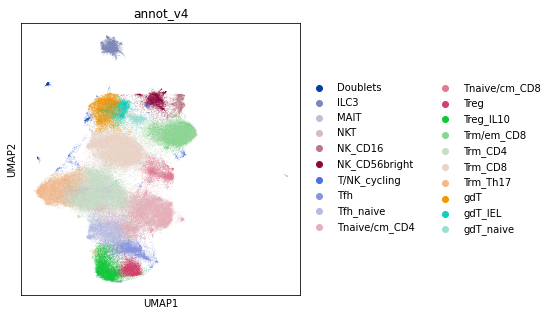

In [342]:
sc.pl.umap(adata,color='annot_v4')

In [346]:
cd8 = adata[adata.obs.annot_v4.isin(['Tnaive/cm_CD8','Trm/em_CD8','Trm_CD8','gdT'])].copy()

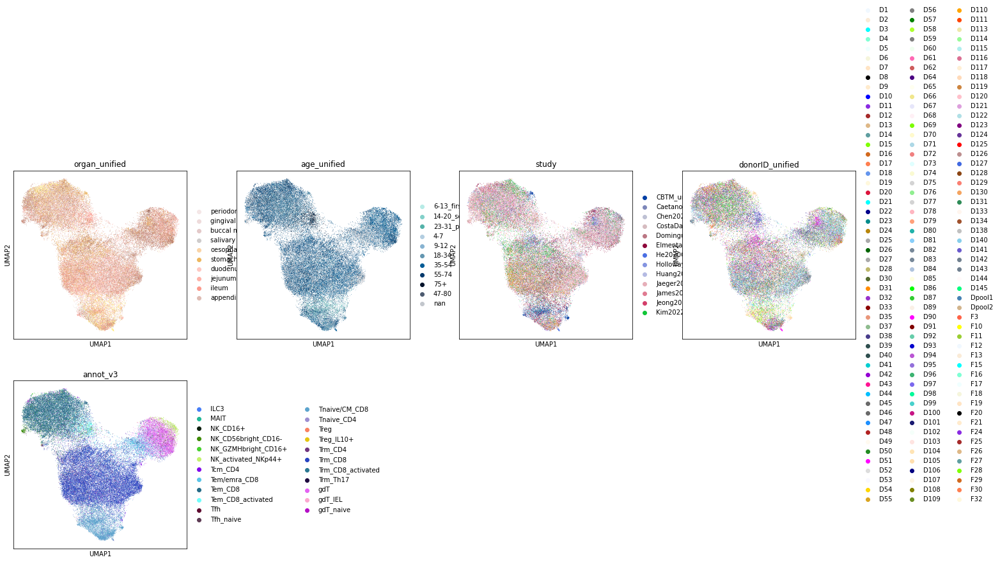

In [347]:
sc.pp.neighbors(
        cd8,
            use_rep="X_scvi",
            n_pcs=cd8.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cd8, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cd8, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

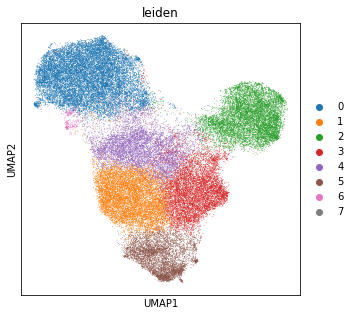

In [349]:
sc.tl.leiden(cd8, resolution = 0.7, neighbors_key="neighbors_scvi")
sc.pl.umap(cd8, color=['leiden'])

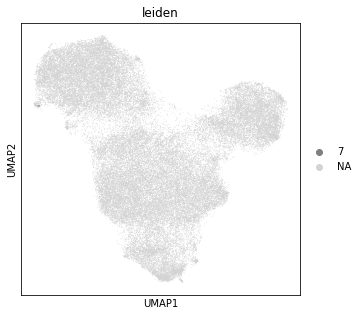

In [354]:
sc.pl.umap(cd8, color=['leiden'],groups='7')

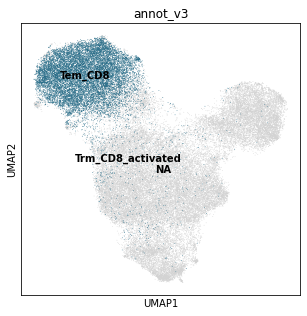

In [352]:
sc.pl.umap(cd8,color='annot_v3',groups=['Tem_CD8','Trm_CD8_activated'],legend_loc='on data')

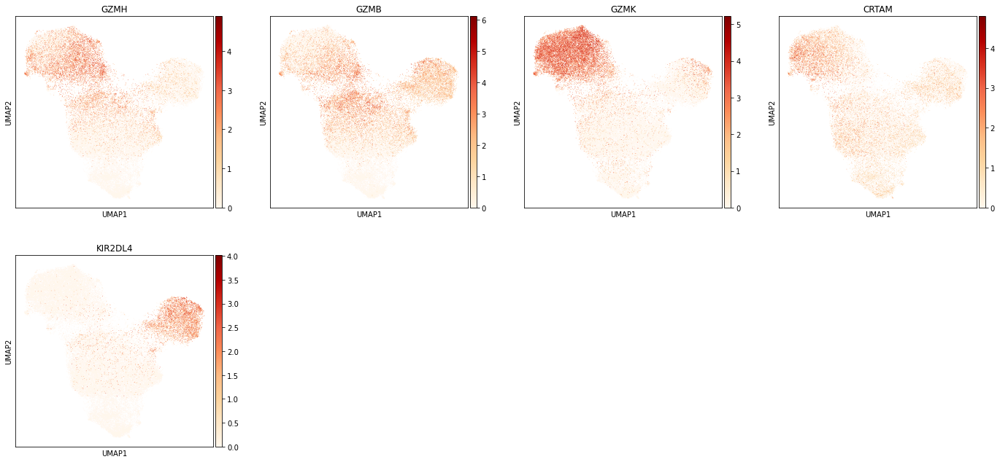

In [351]:
sc.pl.umap(cd8,color=['GZMH','GZMB','GZMK','CRTAM','KIR2DL4'],cmap='OrRd')

In [355]:
new_cluster_names = [
    'Trm/em_CD8','Trm_CD8', #0,1
    'gdT','Trm_CD8', #2,3
    'Trm_CD8','Tnaive/cm_CD8',#4,5
    'Trm/em_CD8','Trm/em_CD8' #6
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cd8.obs['annot_v4'] = [conv[x] for x in cd8.obs['leiden']]

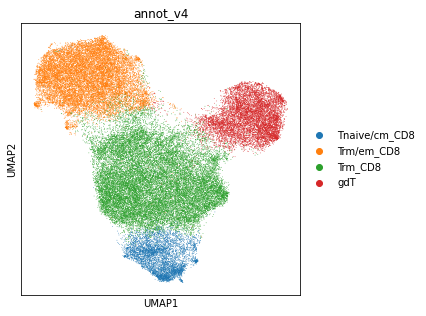

In [356]:
sc.pl.umap(cd8, color=['annot_v4'])

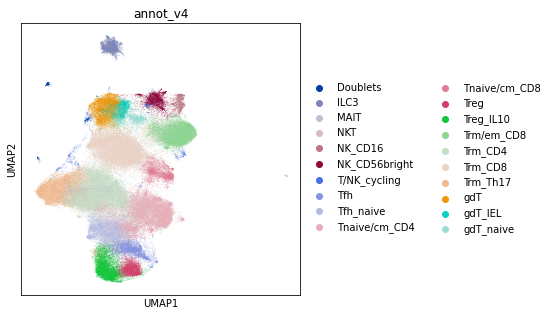

In [357]:
ON = {O:N for O,N in zip(cd8.obs_names,cd8.obs["annot_v4"])}
adata.obs["annot_v4"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v4"])]
sc.pl.umap(adata,color='annot_v4')

In [362]:
adata.obs['annot_v4'] = (
    adata.obs["annot_v4"]
    .map(lambda x: {
 'gdT_IEL':'gdT',
    }.get(x, x))
    .astype("category")
)

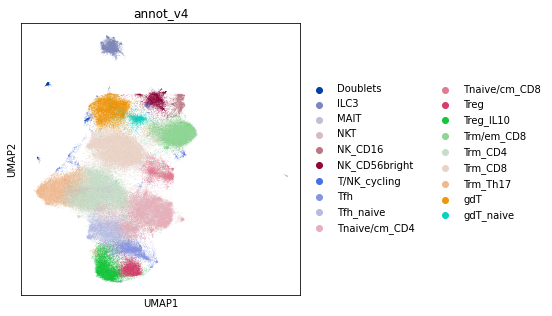

In [363]:
sc.pl.umap(adata,color='annot_v4')

In [364]:
adata.obs['annot_v4'] = (
    adata.obs["annot_v4"]
    .map(lambda x: {
 'NKT':'Doublets',
    }.get(x, x))
    .astype("category")
)

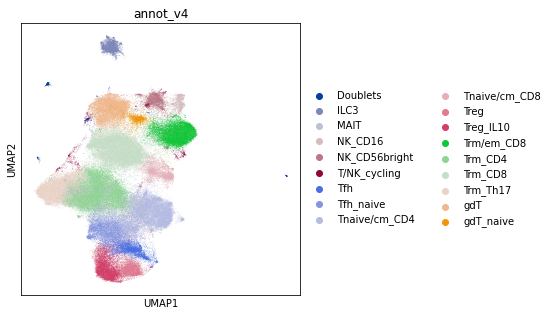

In [365]:
sc.pl.umap(adata,color='annot_v4')

In [367]:
adata.obs.annot_v4.cat.categories

Index(['Doublets', 'ILC3', 'MAIT', 'NK_CD16', 'NK_CD56bright', 'T/NK_cycling',
       'Tfh', 'Tfh_naive', 'Tnaive/cm_CD4', 'Tnaive/cm_CD8', 'Treg',
       'Treg_IL10', 'Trm/em_CD8', 'Trm_CD4', 'Trm_CD8', 'Trm_Th17', 'gdT',
       'gdT_naive'],
      dtype='object')

In [389]:
adata.uns["annot_v4_colors"] = ['#a8a8a8',#doublets
    '#778c00', #ILC3
'#21b796', #MAIT
'#0c1e0e',#NK_CD16
'#3f8c08', #NK CD56
'#c260ff',#T/NK cyling 
'#5e0b30',#Tfh
'#5e3c55',#tfh naive                             
'#9c53bc',#Tnaive/cm CD4
'#5ca4ce',#t naive/CM Cd8
'#f98261',#treg
'#e5c510',#treg il10
'#256b87',#Tem CD8
'#8107ed',#trm cd4                                
'#2844c1',#trm cd8
'#1e093f',#trm th17
'#3fafb5',#gdt                               
'#5ac4e8',#Tem/emra cd8
'#26daf2']#gdt naive

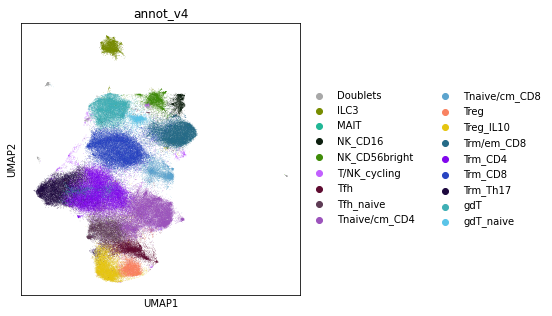

In [390]:
sc.pl.umap(adata,color='annot_v4')

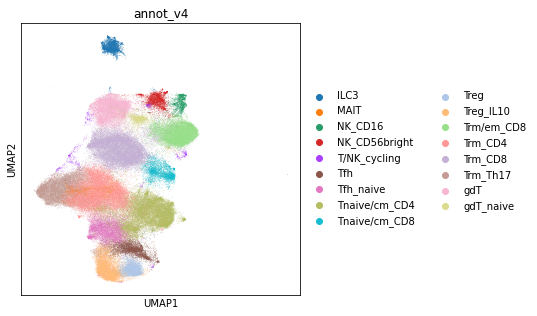

In [374]:
adata_nodoublets = adata[~adata.obs.annot_v4.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v4')

In [27]:
adata_nodoublets.uns["annot_v4_colors"] = [
    '#778c00', #ILC3
'#21b796', #MAIT
'#0c1e0e',#NK_CD16
'#3f8c08', #NK CD56
'#c260ff',#T/NK cyling 
'#5e0b30',#Tfh
'#5e3c55',#tfh naive                             
'#9c53bc',#Tnaive/cm CD4
'#5ca4ce',#t naive/CM Cd8
'#f98261',#treg
'#e5c510',#treg il10
'#256b87',#Tem CD8
'#8107ed',#trm cd4                                
'#2844c1',#trm cd8
'#1e093f',#trm th17
'#3fafb5',#gdt                               
'#5ac4e8',#Tem/emra cd8
'#26daf2']#gdt naive

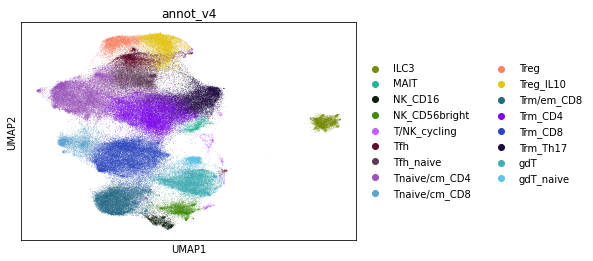

In [28]:
sc.pl.umap(adata_nodoublets,color='annot_v4')

In [391]:
annot = adata.obs.annot_v4

In [392]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v4/csv/T_annotv4.csv')

In [393]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v4/T.hvg5000_noCC.scvi_output.annotv4.nodoublets.22021212.h5ad')

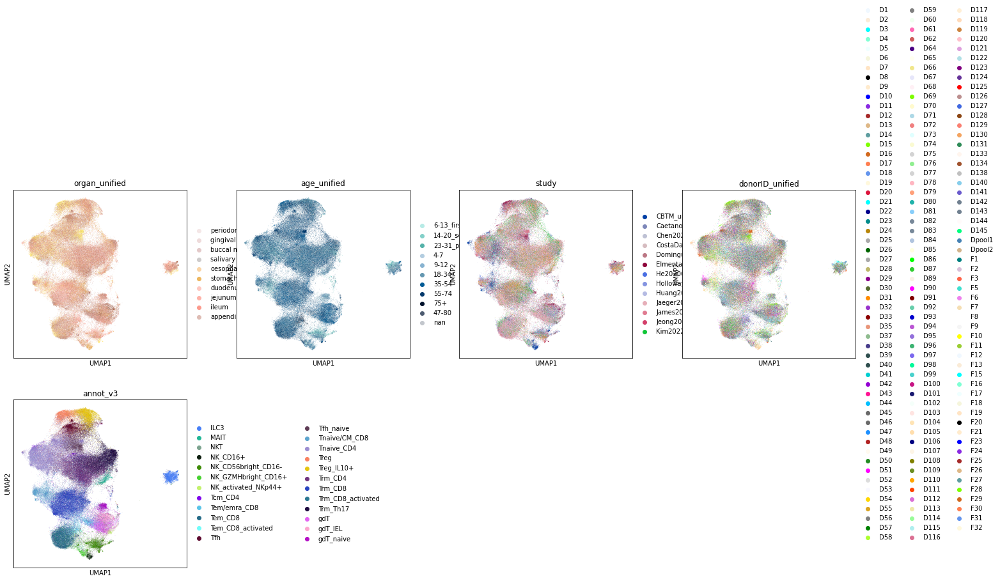

In [394]:
sc.pp.neighbors(
        adata_nodoublets,
            use_rep="X_scvi",
            n_pcs=adata_nodoublets.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(adata_nodoublets, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(adata_nodoublets, color=['organ_unified', 'age_unified','study','donorID_unified','annot_v3'])

In [395]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v4/T.hvg5000_noCC.scvi_output.annotv4.nodoublets.22021212.h5ad')

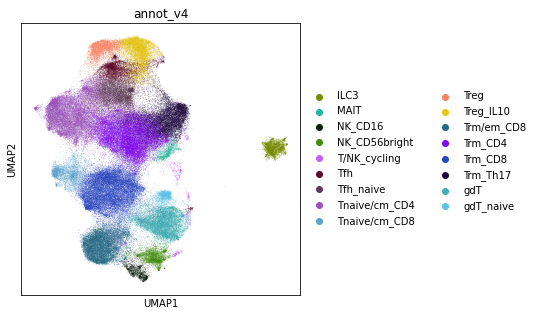

In [396]:
sc.pl.umap(adata_nodoublets,color='annot_v4')

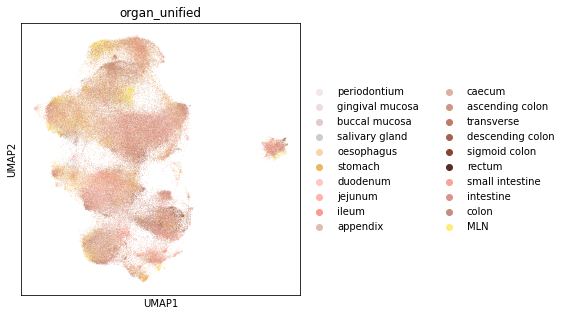

In [32]:
adata.obs['organ_unified'].cat.reorder_categories(['periodontium','gingival mucosa','buccal mucosa',
'salivary gland','oesophagus','stomach','duodenum','jejunum','ileum',
'appendix','caecum',
'ascending colon','transverse','descending colon',
'sigmoid colon','rectum','small intestine','intestine','colon','MLN'], inplace=True)
c_organs_unified = ['#f4e7e7', #peridontium
     '#eedbdb', #gingival mucosa
     '#e3c9c9', #buccal mucosa
     '#cecbcb', #salivary gland
     '#f9d4a7', #oesophagus
     '#edb75f', #stomach
     
     '#fec8c1', #duodenum
     '#feb2a8',#jejunum
     '#fc9a8d',#ileum
     
     '#debcb4',#appendix
     '#deb0a4',#ceacum
     '#cf9686',#ascending colon
     '#bd7c68',#transverse
     '#a36352',#descending
     '#874533', #sigmoid
     '#522e25',#rectum
     '#f5a59a', #small intestine
    '#db948a',#intestine
     '#c28e80',#colon
     '#ffeb7a', #MLN
    ]
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color='organ_unified',palette=c_organs_unified,save='_organ_T.pdf')

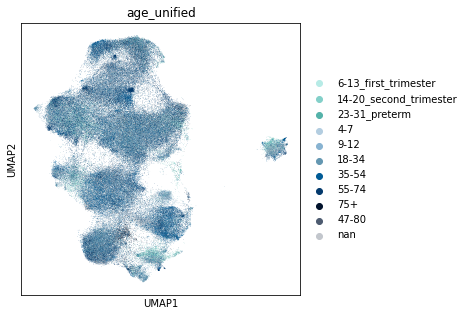

In [33]:
adata.obs['age_unified'].cat.reorder_categories(['6-13_first_trimester','14-20_second_trimester','23-31_preterm','4-7','9-12', 
       '18-34',  '35-54', '55-74', '75+', '47-80','nan'], inplace=True)
c_age_unified = ['#b7ebe6',#'6-13_first_trimester',
                 '#83d0c9',#'14-20_second_trimester',
                 '#54b2a9',#'23-31_preterm',
                 '#b3cde0',#'4-7',
                 '#88b3d1',#'9-12', 
                 '#6497b1',#'18-34',  
                 '#005b96',#'35-54', 
                 '#03396c',#'55-74', 
                 '#01122b',#'75+', 
                 '#4d5b70',#'47-80', 
                 '#c2c6cc',#'nan'
    

]
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color='age_unified',palette=c_age_unified,save='_age_T.pdf')

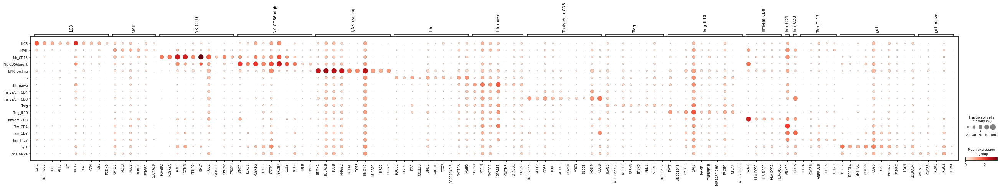

In [42]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="annot_v4")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='annot_v4', mks=mks, n_genes=10)

In [48]:
adata.obs.annot_v4.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/T_annot_v4.csv')

### make plots for figures

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v4/T.hvg5000_noCC.scvi_output.annotv4.nodoublets.22021212.h5ad')

In [4]:
marker_genes_dict = {'General T cell markers': ['CD3D','CD3E','CD3G','CD8A','CD8B','CD4'],
                     'ILC3': ['RORC','PCDH9','KIT','LST1'],
                     'MAIT': ['SLC4A10','TRAV1-2'],
                     'NK_CD16': ['FCGR3A','GNLY','GZMB','NKG7'],
                     'NK_CD56bright': ['XCL1','IL2RB','NCAM1','NCR1'],
                     'T follicular helper markers':['CXCR5','BCL6','PDCD1','CD40LG'],
                     'Naive T cell markers': ['CCR7','SELL'],
                     'Tregs': ['FOXP3','CTLA4','IL10'],
                    'Trm/em_CD8':['GZMK','CRTAM','EOMES'],
                    'Tissue resident memory T markers':['ITGAE','ITGA1','SPRY1'],
                    'Trm_Th17':['IL17A','CCR6','CCL20'],
                    'gdT markers':['KLRC2','TRDC','TRGC1','KIR2DL4']}

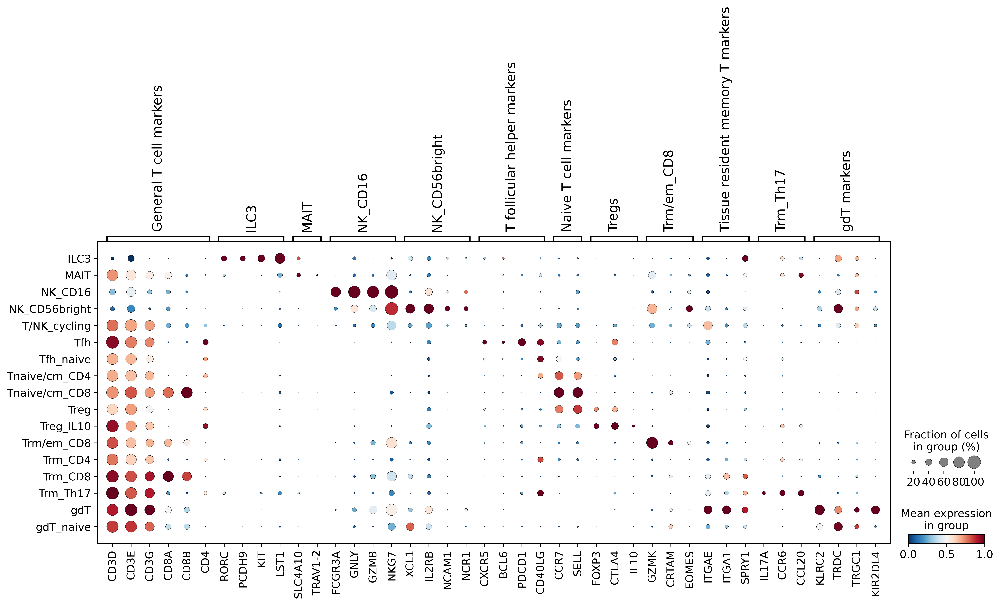

In [11]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='annot_v4',save='T_markers.pdf',color_map='RdBu_r', standard_scale='var')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


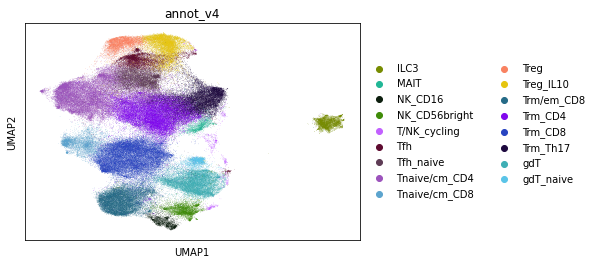

In [6]:
sc.pl.umap(adata,color='annot_v4')

In [7]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

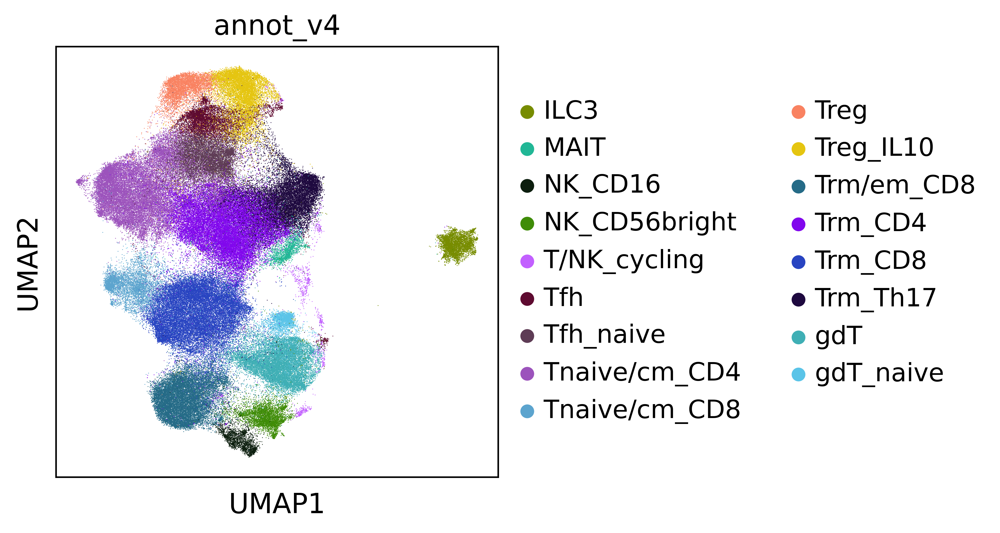

In [8]:
sc.pl.umap(adata,color='annot_v4',save='T_annot.png')

<AxesSubplot: title={'center': 'annot_v4'}, xlabel='UMAP1', ylabel='UMAP2'>

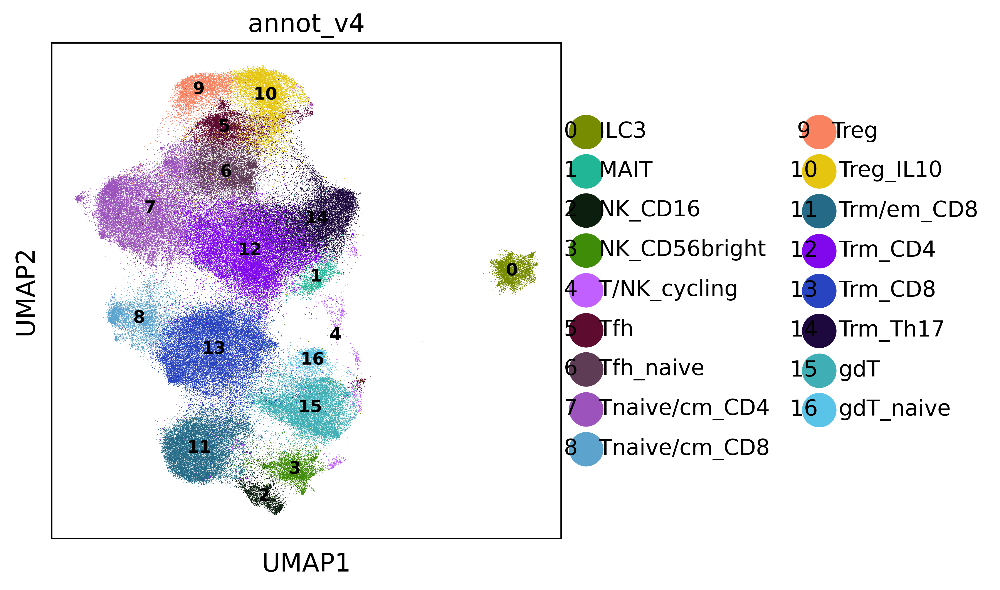

In [9]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="annot_v4",
    figsize=(5, 5),
    save='figures/T_annot.png')